**Problem Statement**

Task 1:-Prepare a complete data analysis report on the given data.

Task 2:-Create a predictive model which will help the bank marketing team to know which customer will buy the product.

Task3:-Suggestions to the Bank market team to make  customers  buy the product.


**Business Case**

**Objective:**

The Business Case of the Portugues Bank is about analizing the banks prospective customers willingness to purchase the term deposit, and to suggest the banks marketing team to improve their promotional activities for the same. all of the given factors pertaining to the banks Term deposit such as a **customers Age, Job, Marital Status, Qualification, previously held housing loan, personal loan, previous campaigns held with regards to promotional activities, employee variation rate, co
consumer price and confidance index, bank landing rate etc will be taken into consideration.**

**_This case is a Binary Classification Case i.e.To predict whether a customer will or will not buy a product (yes/no) therefore, to analize these factors we will be conducting model evaluation techniques such as Support Vector Classification, Naive Bayes, Logistic Regression, Decision Tree Analysis and K-Nearest Neighbors. This will help us identify which customers are likely to buy the product._**

**_Domain Analysis_**

The analysis of the Portuguese Bank Marketing Campaign involves the understanding of various domains that play a significant role in the success of the campaign.

**Banking Domain:**

**Understanding Banking Products:**

Familiarity with banking products, including term deposits, loans,and other financial services. (Columns Covered: Term Deposits, Housing, Loan)

**Customer Account Management:** 

Banks maintain extensive customer databases, containing demographic information, transaction history, and contact details. Leveraging this data is crucial for targeted marketing campaigns and personalized customer interactions. (Colums Covered: Age,Marital Staus, Job, Education, default,)

**Marketing Domain:**

Marketing Strategies: Knowledge of various marketing strategies, including direct phone calls Vs Cellular campaigns. (Contact, Month, day of the week, pdays)

**Economic Indicators:**

**- Economic Context:** 

Awareness of economic indicators like employment variation rate, consumer price index, consumer confidence index, etc., and their potential impact on customer behavior and purchasing decisions. 

**_The domain analysis helps align the problem statement with relevant knowledge and best practices to ensure a successful data analysis and predictive modeling project._**

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
#Loading the data
data=pd.read_csv('bank-additional-full.csv',sep=";")

## Model - 1  Logistic Regression

## Basic Checks

In [28]:
data.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [29]:
data.tail()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes
41187,74,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,3,999,1,failure,-1.1,94.767,-50.8,1.028,4963.6,no


In [16]:
data.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,93.575664,-40.502600,3.621291,5167.035911
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,0.578840,4.628198,1.734447,72.251528
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


In [17]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

In [18]:
print(data.shape)   # Get the dimensions of the dataset (rows, columns)


(41188, 21)


## Exploratory Data analysis

In [162]:
## Renaming the Target Variable

# Rename the column
data.rename(columns={'y': 'TermDeposit'}, inplace=True)


In [20]:
data.head(5)

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,TermDeposit
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [21]:
## Univariate Analysis
!pip install sweetviz

In [22]:
import sweetviz as sv#importing sweetviz library 
my_report = sv.analyze(data)#syntax to use sweetviz
my_report.show_html()#Default arguments will generate to "SWEETVIZ_REPORT.html"

                                             |                                             | [  0%]   00:00 ->…

Report SWEETVIZ_REPORT.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# Insights:
**Age:**
The age of clients ranges from a min of 17 to a max of 98.
There's a concentration of clients within age group of about 28 to 58 with the median age being 38.

**Job:**
Dominant Job Categories: The top job categories in terms of client representation are:
Admin: 10,422 clients, accounting for approximately 25% of the dataset.
Blue-collar: 9,254 clients, representing around 22% of the dataset.
Technician: 6,743 clients, making up about 16% of the dataset.

**Marital Status:**

Married Clients: The majority of clients in the dataset are married, accounting for approximately 61% of the total clients.
Single Clients: Single individuals make up around 28% of the dataset. 
Divorced Clients: Divorced individuals constitute approximately 11% of the dataset.
Representation of "Unknown" Status: The dataset also includes a small percentage of clients with an "unknown" marital status (less than 1%).

**Eduaction**

University Degree:  Approximately 30% of the total clients have a university degree making this the largest group in the dataset.
High School Graduates: High school graduates represent around 23% of the dataset, making them the second-largest group.
Basic Education Levels: Clients with basic education levels (9 years, 4 years, and 6 years of education) together make up around 31% of the dataset.
Professional Course: Clients who completed a professional course constitute approximately 13% of the dataset.
Unknown Education Status: The dataset also includes a small percentage of clients with an "unknown" education level (around 4%).
Illiterate Clients: The dataset contains a negligible percentage of illiterate clients (less than 1%).


**Default**

No Credit Default: The majority of clients (almost 80%) do not have any outstanding credit defaults.
Unknown Default Status: A significant percentage of clients (around 21%) have an "unknown" default status. 
Clients with Default: A small percentage of clients (less than 1%) have defaulted on their credit.

**Housing**

Clients with Housing Loan: Approximately 52% of the clients have a housing loan ("yes").
Clients without Housing Loan: Around 45% of the clients do not have a housing loan ("no"). 
Unknown Housing Status: A small percentage of clients (approximately 2%) have an "unknown" housing status. 

**Loans**
Clients without Personal Loan: Approximately 82% of the clients do not have a personal loan ("no"). 
Clients with Personal Loan: Around 15% of the clients have a personal loan ("yes").
Unknown Loan Status: A small percentage of clients (approximately 2%) have an "unknown" loan status. Similar to other unknown status categories, this might be due to incomplete data or clients not providing information about their personal loan status.

**Contact**
Cellular Communication: The majority of clients (approximately 63%) were contacted via cellular communication. This suggests that cellular communication was the more frequently used method during the marketing campaign.

Telephone Communication: Around 37% of the clients were contacted via telephone communication. While cellular communication was more prevalent, telephone communication still constituted a substantial portion of the contact methods.

**Month**

Contact Concentration in May: May has the highest number of client contacts, with approximately 33% of the total clients being contacted during this month. This indicates that May was the most active month in terms of client outreach.

 May, July, and August have relatively higher contact numbers compared to other months.

Not vital to our model calculation and will need to be dropped.

**Day of the week**
Peak Contact Days: Thursday and Monday are the days with the highest number of client contacts, each accounting for approximately 21% of the total contacts. 

Weekend Contacts: The data indicates that the bank made fewer client contacts during the weekend (Saturday and Sunday).

**Duration**

The "duration" column in the dataset represents the duration of contact with clients during the marketing campaign.
Important note: this attribute highly affects the output target (e.g., if duration=0 then y/TermDeposit='no'). Yet, the duration is not known before a call is performed. Also, after the end of the call y- in  our case TermDeposit is obviously known. Thus, this input should only be included for benchmark purposes and should be discarded if the intention is to have a realistic predictive model.


**Campaign**

 The most common number of contacts performed during this campaign with clients during the campaign is "1" (42.8% of the total contacts), followed by "2" (25.7%) and "3" (13.0%).

**Pdays**
Most Frequent pdays Values: The most common value for "pdays" is "999," which indicates that the client was not previously contacted in a previous campaign (67.3% of the total). The next most frequent values are "3" (11.1%), "6" (10.0%), and "4" (8.3%).
Recent Contacts: The high frequency of small "pdays" values (e.g., 3, 6, 4) suggests that a significant number of clients were contacted relatively recently after a previous campaign.

999 Value Significance: The high frequency of "999" indicates that a substantial portion of clients were not previously contacted,

Recent Contacts: The high frequency of small "pdays" values (e.g., 3, 6, 4) suggests that a significant number of clients were contacted relatively recently after a previous campaign.

**Previous**
The "previous" column represents the number of contacts made with a client before the current marketing campaign.

Most Frequent Previous Values: The most common value for "previous" is "0," indicating that a significant proportion of clients (approximately 86%) were not previously contacted before the current campaign. The next most frequent values of contact are "1" (approximately 11.1%) and "2" (approximately 5.4%).

**poutcome**
Nonexistent Outcome: The most common outcome in the "poutcome" column is "nonexistent," which indicates that a significant proportion of clients (approximately 86%) did not have a previous marketing campaign. This means that they were not contacted in any previous marketing effort.

Failure Outcome: The second most frequent outcome is "failure," representing approximately 10% of the clients. This indicates that a notable portion of clients had a previous marketing campaign that resulted in a failure, such as not subscribing to the product or service.

**emp.var.rate**
Positive and Negative Employment Variation: The "emp.var.rate" column contains both positive and negative values. Positive values, such as 1.416, 1.17, and 0.210, indicate periods of economic growth and improvement in the employment market. Negative values, such as -1.89, -0.13, and -1.777, indicate periods of economic downturn and decreased employment opportunities.

**cons.price.idx**
This index measures changes in the prices of goods and services purchased or acquired by households;Stable Consumer Price Index: The most common consumer price index values are approximately 93.9947 (18.8%), 93.9186 (16.2%), and 92.8935 (14.1%). This suggests that the consumer price index remained relatively stable during the campaign period.

**consumer confidence index**

The most common consumer confidence index values are negative, such as -36.47 (18.8%), -42.76 (16.2%), and -46.25 (14.1%). Negative values in the consumer confidence index indicate that consumers are generally pessimistic about the economy.This would help us gain insights on whether the customers would have the resources to purchase the term deposit of the portugues bank.

**euribor3m**
The "euribor3m" column represents the 3-month Euribor (Euro Interbank Offered Rate) interest rate, which is an important benchmark rate used in the eurozone for interbank lending.
The most common Euribor3m rates are approximately 4.8572 (86.87%), 4.9622 (61.36%), and 4.9632 (48.76%). These rates indicate that during the campaign period, the interest rates were relatively high.

**nr.employed**

Most Frequent Values: The most common number of employees during the campaign are approximately 5228.116 (39.4%), 5099.18 (20.7%), and 5191.07 (18.8%). These values indicate that the bank's workforce varied during the campaign period.

** 'Y' renamed to Term deposit**

The "TermDeposit" outcome shows, approximately 89% of clients not subscribing to a term deposit ("no") and only about 11% of clients subscribing ("yes").

## Bi-Variate Analysis

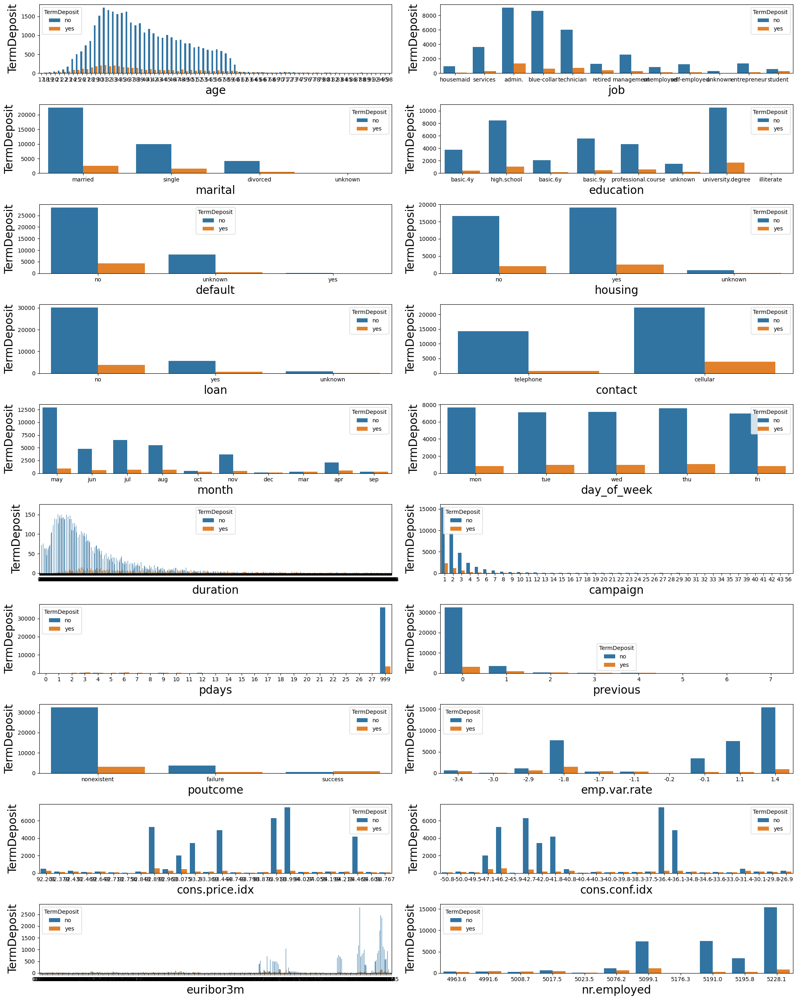

In [31]:
plt.figure(figsize=(20,25), facecolor='white')#To set canvas 
plotnumber = 1#counter

for column in data:#accessing the columns 
    if plotnumber<=20 :
        ax = plt.subplot(10,2,plotnumber)
        sns.countplot(x=data[column]
                        ,hue=data.TermDeposit)
        plt.xlabel(column,fontsize=20)#assign name to x-axis and set font-20
        plt.ylabel('TermDeposit',fontsize=20)
    plotnumber+=1#counter increment
plt.tight_layout()

# Insights:
- **Age:** A concentration of clients within 30-40 age groups have higher subscription rates. 
- **Job:**Admin, blue-collar and technician followed by management tend to subscribe more
- **MaritalStatus:**Married subscribed more than unmarried and divorced
- **Education:** University Degree holders and high school graduates subscribe more
- **Housing and Loan:** Customers  without housing and personal loan tend to subscribe to term deposit
- **Contact:** Customers approached by cellular communication have subscribed more
- **Month:** Subscription rate is more during  May, jan,july and August
- **Campaign and previous:** Customers who subscribed during previous campaign tend to subscribe more
- **Deafult:** Non-defaulters tend to subscribe more



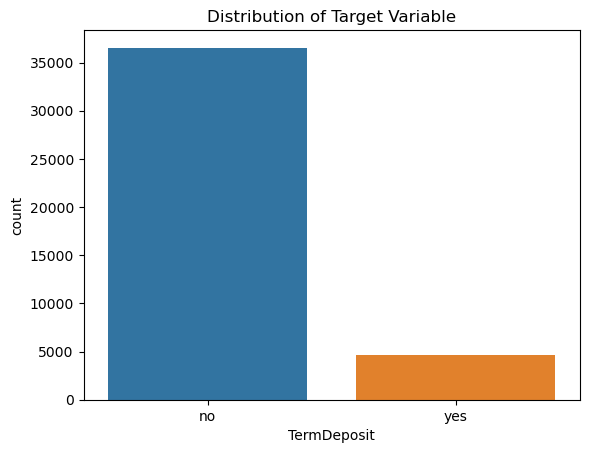

In [32]:
# Check the distribution of the target variable
sns.countplot(x='TermDeposit', data=data)
plt.title('Distribution of Target Variable')
plt.show()

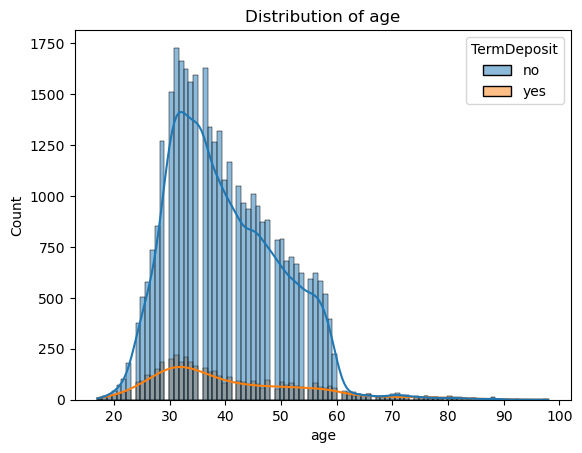

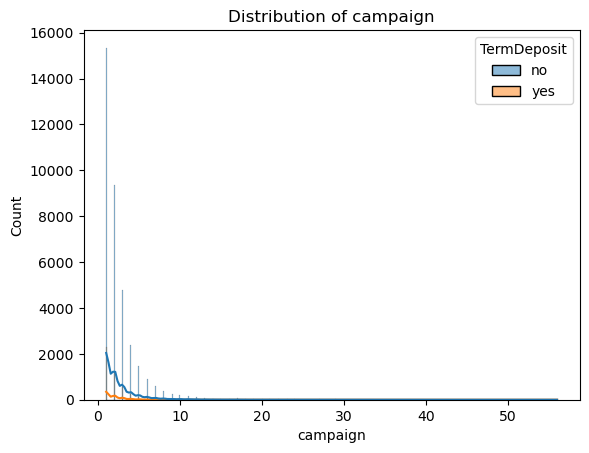

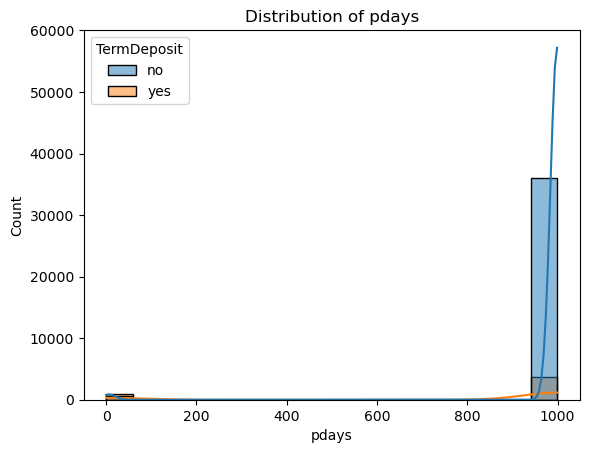

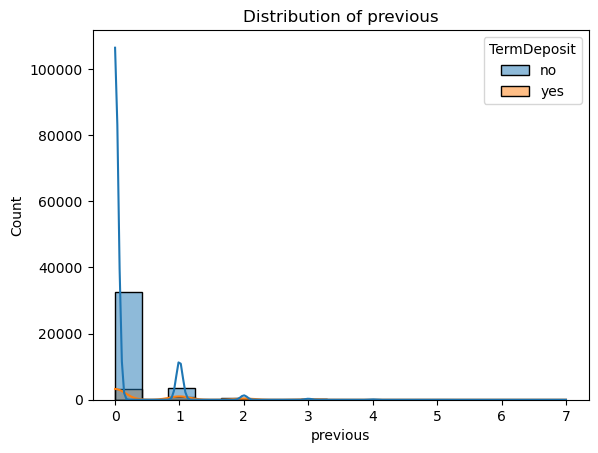

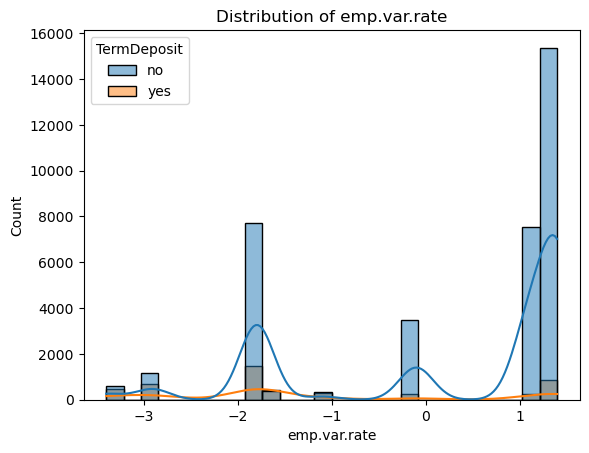

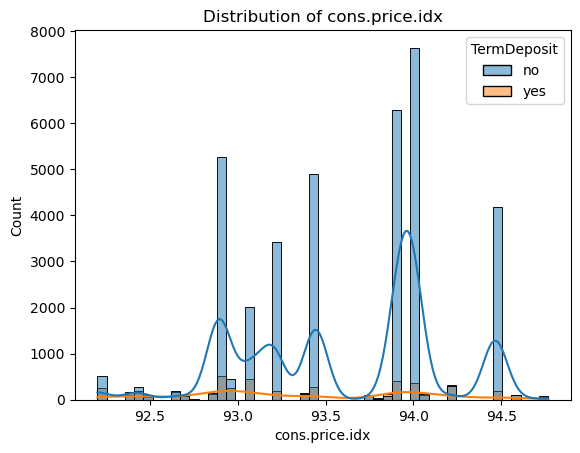

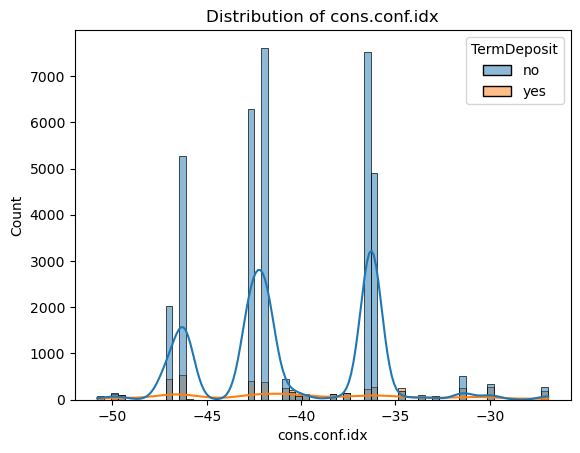

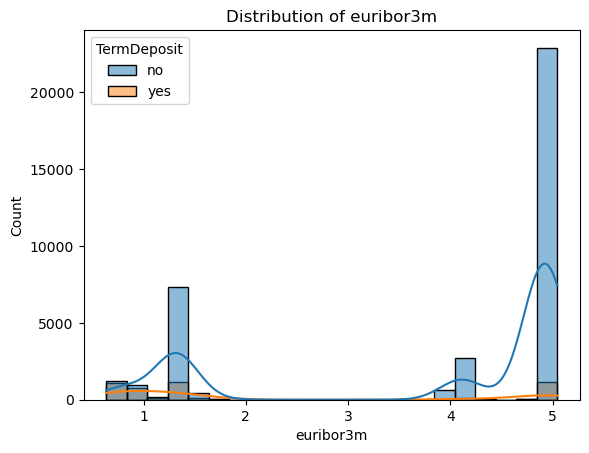

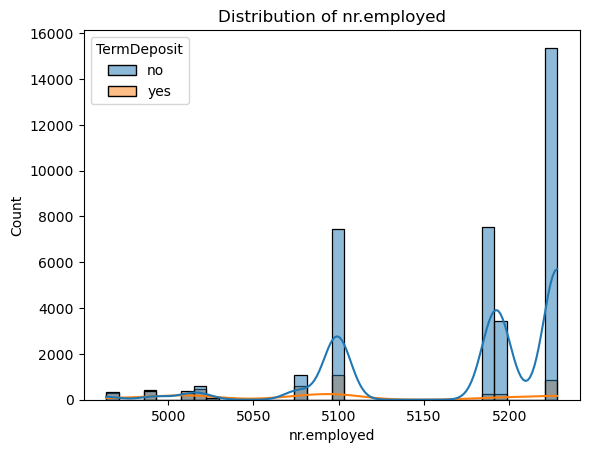

In [163]:
# Explore the distribution of numerical features
numerical_cols = ['age', 'campaign', 'pdays', 'previous', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed']
for col in numerical_cols:
    sns.histplot(data=data, x=col, hue='TermDeposit', kde=True)
    plt.title(f'Distribution of {col}')
    plt.show()


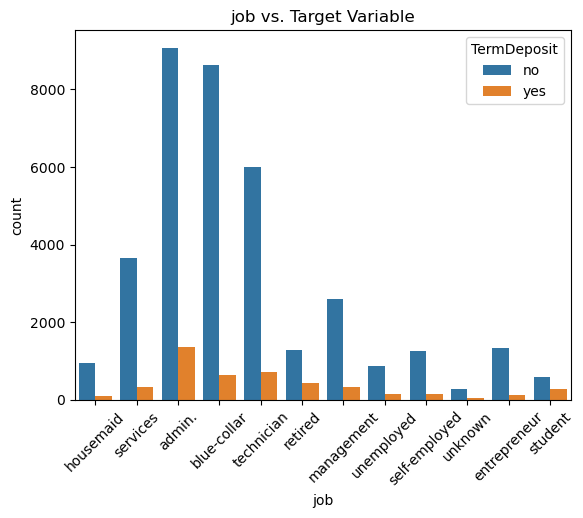

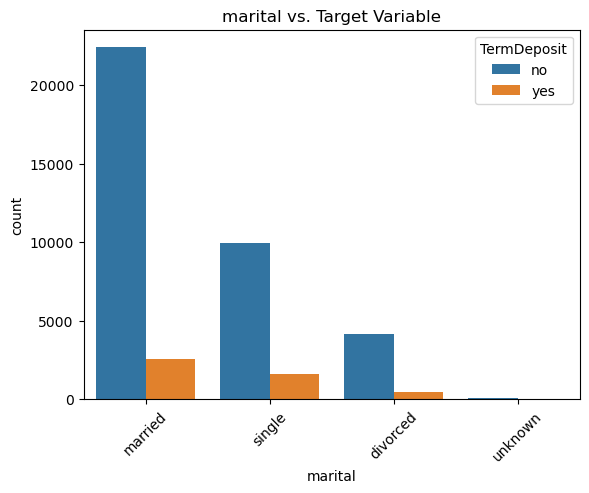

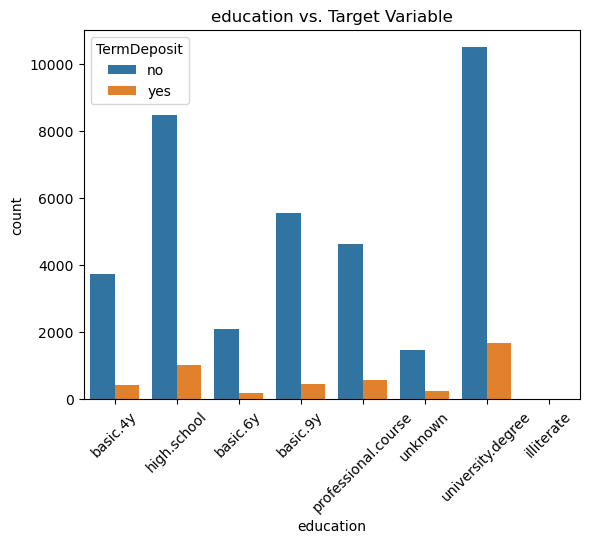

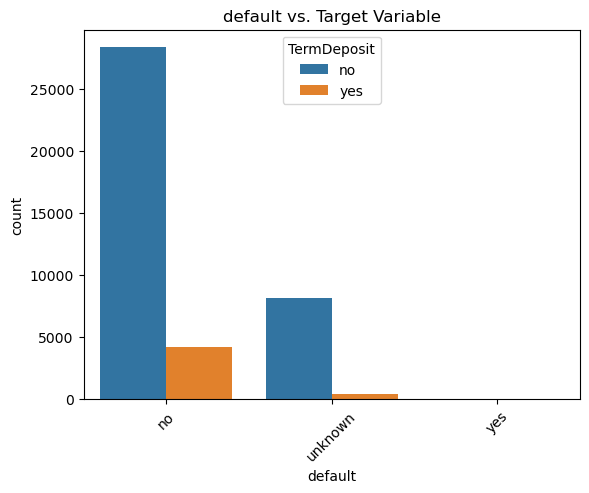

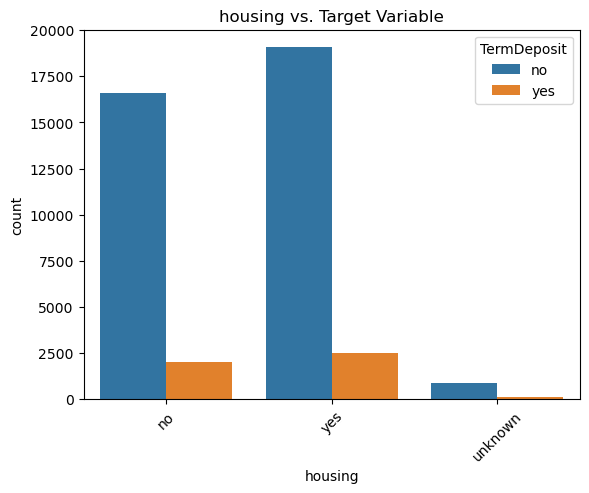

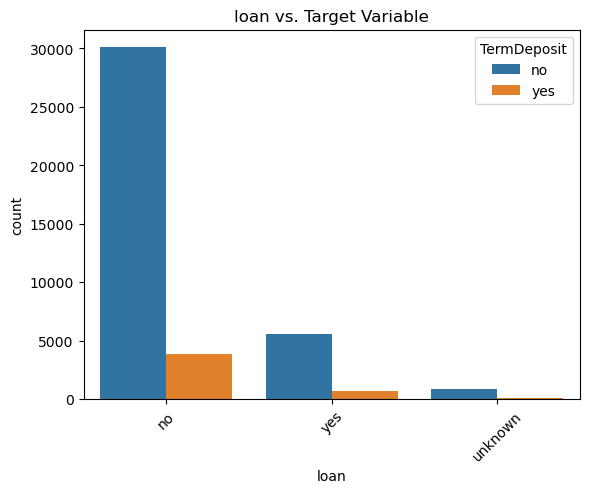

In [164]:
# Explore the relationship between categorical variables and the target variable
categorical_cols = ['job', 'marital', 'education', 'default', 'housing', 'loan']
for col in categorical_cols:
    sns.countplot(x=col, hue='TermDeposit', data=data)
    plt.title(f'{col} vs. Target Variable')
    plt.xticks(rotation=45)
    plt.show()


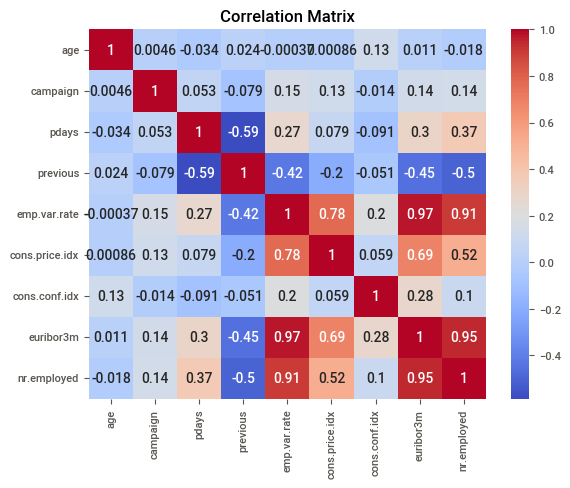

In [15]:
# Explore the correlation between numerical features
correlation = data[numerical_cols].corr()
sns.heatmap(correlation, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

# Data Pre-processing and Feature Engineering

 Steps to perform in Feature engineering/data preprocessing

1)Check missing values.Check for corrupted values if any.
2)Convert categorical variable into numerical
3)Handle outlier.
4)Scale the data
5)Transformation of data
6)Balance the data.

In [93]:
## get the missing values
data.isnull().sum()

age               0
job               0
marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
TermDeposit       0
dtype: int64

In [4]:
# Check for "unknown" values in each column
for column in data.columns:
    unknown_count = data[column].loc[data[column] == 'unknown'].count()
    if unknown_count > 0:
        print(f"Column '{column}' has {unknown_count} 'unknown' values.")

Column 'job' has 330 'unknown' values.
Column 'marital' has 80 'unknown' values.
Column 'education' has 1731 'unknown' values.
Column 'default' has 8597 'unknown' values.
Column 'housing' has 990 'unknown' values.
Column 'loan' has 990 'unknown' values.


In [17]:
print(data['job'].unique())

['housemaid' 'services' 'admin.' 'blue-collar' 'technician' 'retired'
 'management' 'unemployed' 'self-employed' 'unknown' 'entrepreneur'
 'student']


In [18]:
print(data['marital'].unique())

['married' 'single' 'divorced' 'unknown']


In [19]:
print(data['education'].unique())

['basic.4y' 'high.school' 'basic.6y' 'basic.9y' 'professional.course'
 'unknown' 'university.degree' 'illiterate']


In [20]:
print(data['default'].unique())

['no' 'unknown' 'yes']


In [21]:
print(data['housing'].unique())

['no' 'yes' 'unknown']


In [22]:
print(data['loan'].unique())

['no' 'yes' 'unknown']


In [5]:
#  replace "unknown" values with NaN and then drop rows with NaN values for simplicity:

# Replace "unknown" values with NaN
data.replace('unknown', pd.NA, inplace=True)

# Get the number of rows before dropping NaN values
num_rows_before = len(data)

# Drop rows with NaN values
data.dropna(inplace=True)

# Get the number of rows after dropping NaN values
num_rows_after = len(data)

# Print the results
print(f"Number of rows before dropping 'unknown' values: {num_rows_before}")
print(f"Number of rows after dropping 'unknown' values: {num_rows_after}")

# Now the dataset does not contain rows with "unknown" values

Number of rows before dropping 'unknown' values: 41188
Number of rows after dropping 'unknown' values: 30488


In [6]:
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split

# Drop unnecessary columns

In [7]:
data = data.drop(['duration', 'contact', 'month', 'day_of_week', 'poutcome'], axis=1)

# Explanation as to why the above columns were dropped

*duration-It is typically not known beforehand whether a customer will subscribe to the bank's product or service, and the duration of the call itself can heavily influence the outcome. By removing this column, one prevents the model from relying on a variable that would not be available in a real-time scenario, thus avoiding potential bias.
*'contact', 'month', 'day_of_week': These variables may not provide significant predictive power or may introduce noise to the model. In such cases, it is in the best interests to remove them to simplify the model and improve interpretability.
*'poutcome': This column represents the outcome of the previous marketing campaign for the same client.Removing it can help avoid relying on information that may not be relevant or reliable.

In [27]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30488 entries, 0 to 41187
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             30488 non-null  int64  
 1   job             30488 non-null  object 
 2   marital         30488 non-null  object 
 3   education       30488 non-null  object 
 4   default         30488 non-null  object 
 5   housing         30488 non-null  object 
 6   loan            30488 non-null  object 
 7   campaign        30488 non-null  int64  
 8   pdays           30488 non-null  int64  
 9   previous        30488 non-null  int64  
 10  emp.var.rate    30488 non-null  float64
 11  cons.price.idx  30488 non-null  float64
 12  cons.conf.idx   30488 non-null  float64
 13  euribor3m       30488 non-null  float64
 14  nr.employed     30488 non-null  float64
 15  TermDeposit     30488 non-null  object 
dtypes: float64(5), int64(4), object(7)
memory usage: 4.0+ MB


# Convert categorical variables to numerical using label encoding

In [8]:
from sklearn.preprocessing import LabelEncoder
categorical_cols = ['job', 'marital', 'education', 'default', 'housing', 'loan']
lc = LabelEncoder()
data[categorical_cols] = data[categorical_cols].apply(lc.fit_transform)

In [29]:
data.head(5)

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,TermDeposit
0,56,3,1,0,0,0,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,no
2,37,7,1,3,0,1,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,no
3,40,0,1,1,0,0,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,no
4,56,7,1,3,0,0,1,1,999,0,1.1,93.994,-36.4,4.857,5191.0,no
6,59,0,1,5,0,0,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,no


In [30]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30488 entries, 0 to 41187
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             30488 non-null  int64  
 1   job             30488 non-null  int32  
 2   marital         30488 non-null  int32  
 3   education       30488 non-null  int32  
 4   default         30488 non-null  int32  
 5   housing         30488 non-null  int32  
 6   loan            30488 non-null  int32  
 7   campaign        30488 non-null  int64  
 8   pdays           30488 non-null  int64  
 9   previous        30488 non-null  int64  
 10  emp.var.rate    30488 non-null  float64
 11  cons.price.idx  30488 non-null  float64
 12  cons.conf.idx   30488 non-null  float64
 13  euribor3m       30488 non-null  float64
 14  nr.employed     30488 non-null  float64
 15  TermDeposit     30488 non-null  object 
dtypes: float64(5), int32(6), int64(4), object(1)
memory usage: 3.3+ MB


In [9]:
# Create dummy variables for the remaining categorical variables
data = pd.get_dummies(data, drop_first=True)

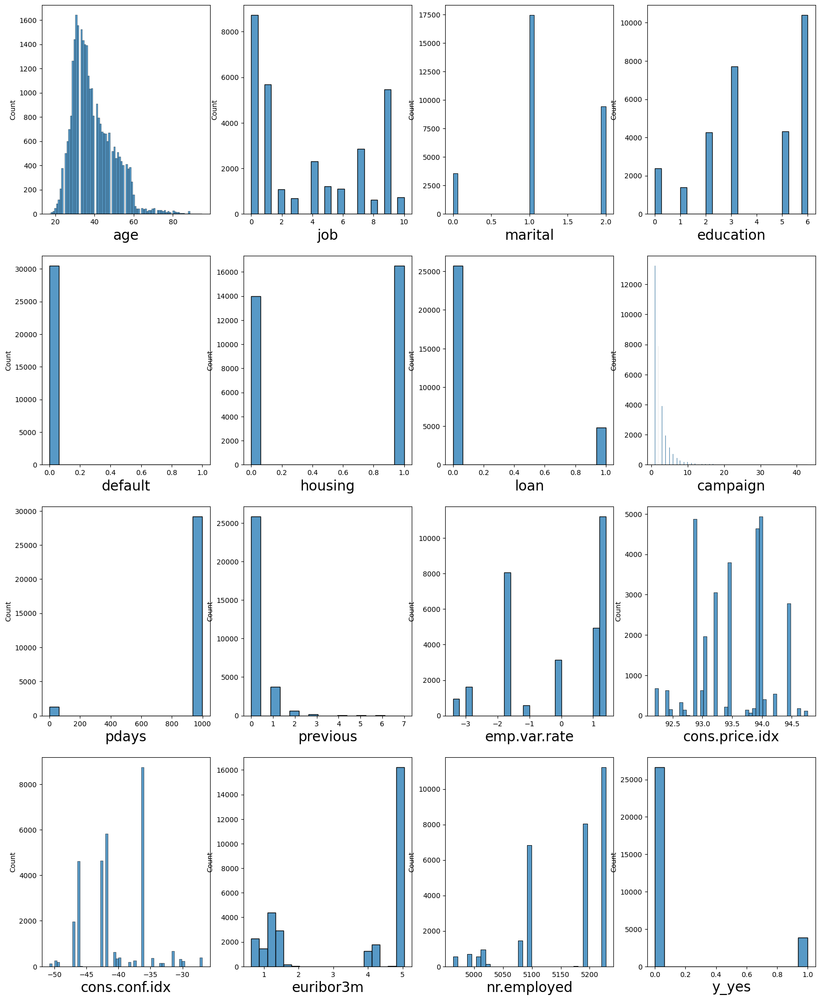

In [10]:
# let's see how data is distributed for every column
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in data:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.histplot(data[column]) 
        plt.xlabel(column,fontsize=20)
        
    plotnumber+=1
plt.show()

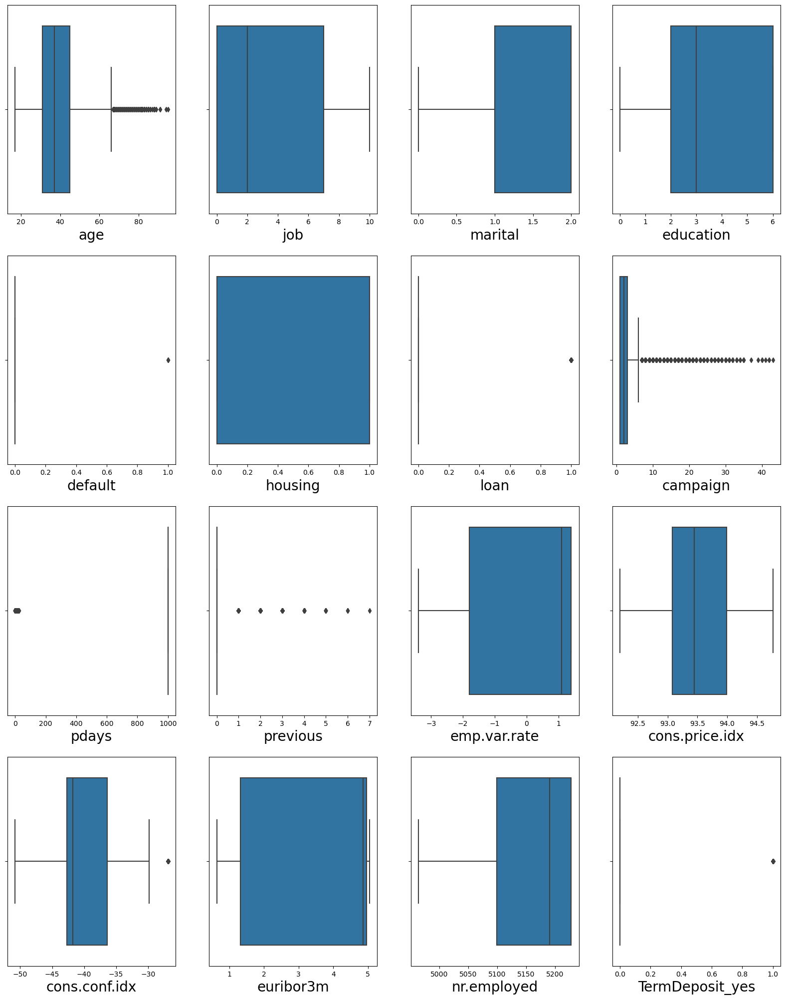

In [43]:
# Checking for outliers
# let's see how data is distributed for every column
import warnings
warnings.filterwarnings('ignore')
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in data:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.boxplot(data[column]) 
        plt.xlabel(column,fontsize=20)
        
    plotnumber+=1
plt.show()

In [11]:
def calculate_outlier_percentage(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    outlier_threshold = 1.5 * IQR
    
    num_outliers = ((column < Q1 - outlier_threshold) | (column > Q3 + outlier_threshold)).sum()
    percentage_outliers = (num_outliers / len(column)) * 100
    return percentage_outliers

In [13]:
numerical_cols = ['age', 'campaign', 'pdays', 'previous', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed']

In [14]:
# Calculate the percentage of outliers for each numerical column
outlier_percentages = {column: calculate_outlier_percentage(data[column]) for column in numerical_cols}
print("Percentage of outliers in each numerical feature:")
print(outlier_percentages)

Percentage of outliers in each numerical feature:
{'age': 1.5022303857255315, 'campaign': 5.4939648386250335, 'pdays': 4.296772500655996, 'previous': 15.258462345840988, 'emp.var.rate': 0.0, 'cons.price.idx': 0.0, 'cons.conf.idx': 1.2988716872212016, 'euribor3m': 0.0, 'nr.employed': 0.0}


In [15]:
def remove_outliers_zscore(dataframe, threshold=3):
  
    # Create an empty DataFrame to store the filtered data
    filtered_data = pd.DataFrame()

    # Loop through all columns in the DataFrame
    for column in dataframe.columns:
        
        # Calculate the Z-score for the current column
        z_scores = (dataframe[column] - dataframe[column].mean()) / dataframe[column].std()
# Filter out the rows with Z-scores above the threshold for the current column
        filtered_data[column] = dataframe[abs(z_scores) < threshold][column]
    
    return filtered_data

# Example usage:
# Assuming you have a DataFrame called 'df' containing all your data
data_cleaned = remove_outliers_zscore(data)

In [16]:
# Calculate the percentage of outliers for each numerical column
outlier_percentages = {column: calculate_outlier_percentage(data_cleaned[column]) for column in numerical_cols}
print("Percentage of outliers in each numerical feature:")
print(outlier_percentages)

Percentage of outliers in each numerical feature:
{'age': 0.4046166091801539, 'campaign': 3.555319713451844, 'pdays': 0.0, 'previous': 12.171663571239055, 'emp.var.rate': 0.0, 'cons.price.idx': 0.0, 'cons.conf.idx': 1.177368002122579, 'euribor3m': 0.0, 'nr.employed': 0.0}


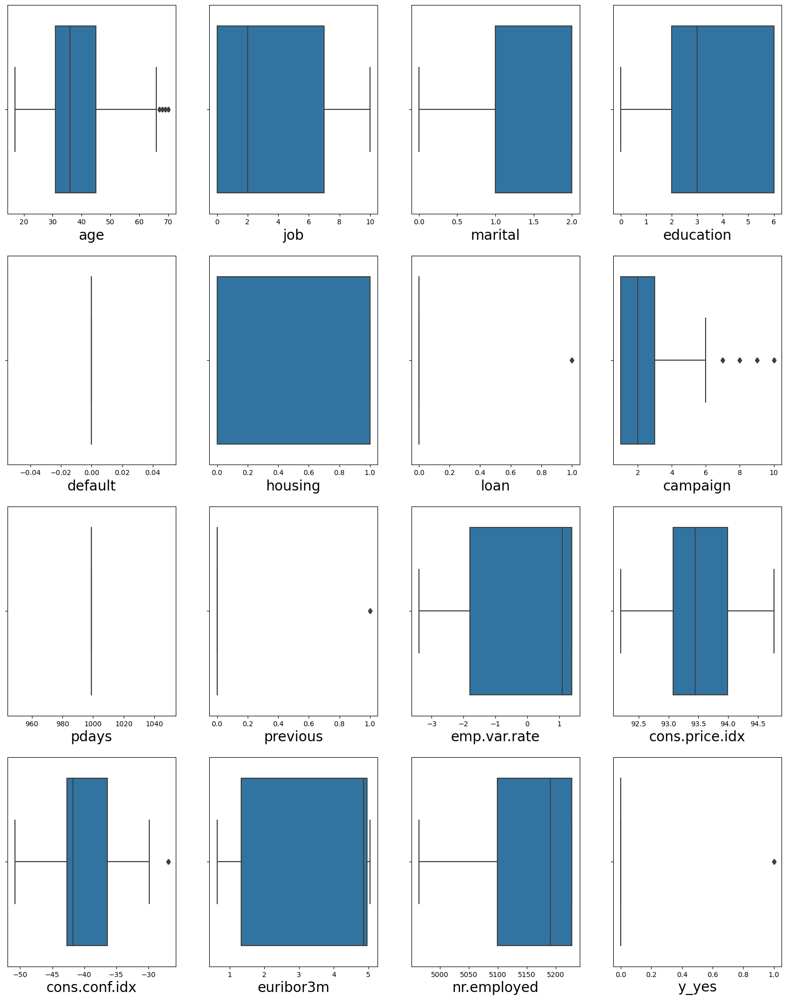

In [17]:
# Checking for outliers
# let's see how data is distributed for every column
import warnings
warnings.filterwarnings('ignore')
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in data:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.boxplot(data_cleaned[column]) 
        plt.xlabel(column,fontsize=20)
        
    plotnumber+=1
plt.show()

#Feature Selection
# Steps to follow in feature selection
1)Removing redundant columns-->one unique value columns,ids columns,
serial no.
2)Check for highly correlated features.
If correlation between 2 numerical feature is more than 0.9,remove one of them.


In [36]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30488 entries, 0 to 41187
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   age              30488 non-null  int64  
 1   job              30488 non-null  int32  
 2   marital          30488 non-null  int32  
 3   education        30488 non-null  int32  
 4   default          30488 non-null  int32  
 5   housing          30488 non-null  int32  
 6   loan             30488 non-null  int32  
 7   campaign         30488 non-null  int64  
 8   pdays            30488 non-null  int64  
 9   previous         30488 non-null  int64  
 10  emp.var.rate     30488 non-null  float64
 11  cons.price.idx   30488 non-null  float64
 12  cons.conf.idx    30488 non-null  float64
 13  euribor3m        30488 non-null  float64
 14  nr.employed      30488 non-null  float64
 15  TermDeposit_yes  30488 non-null  uint8  
dtypes: float64(5), int32(6), int64(4), uint8(1)
memory usage: 

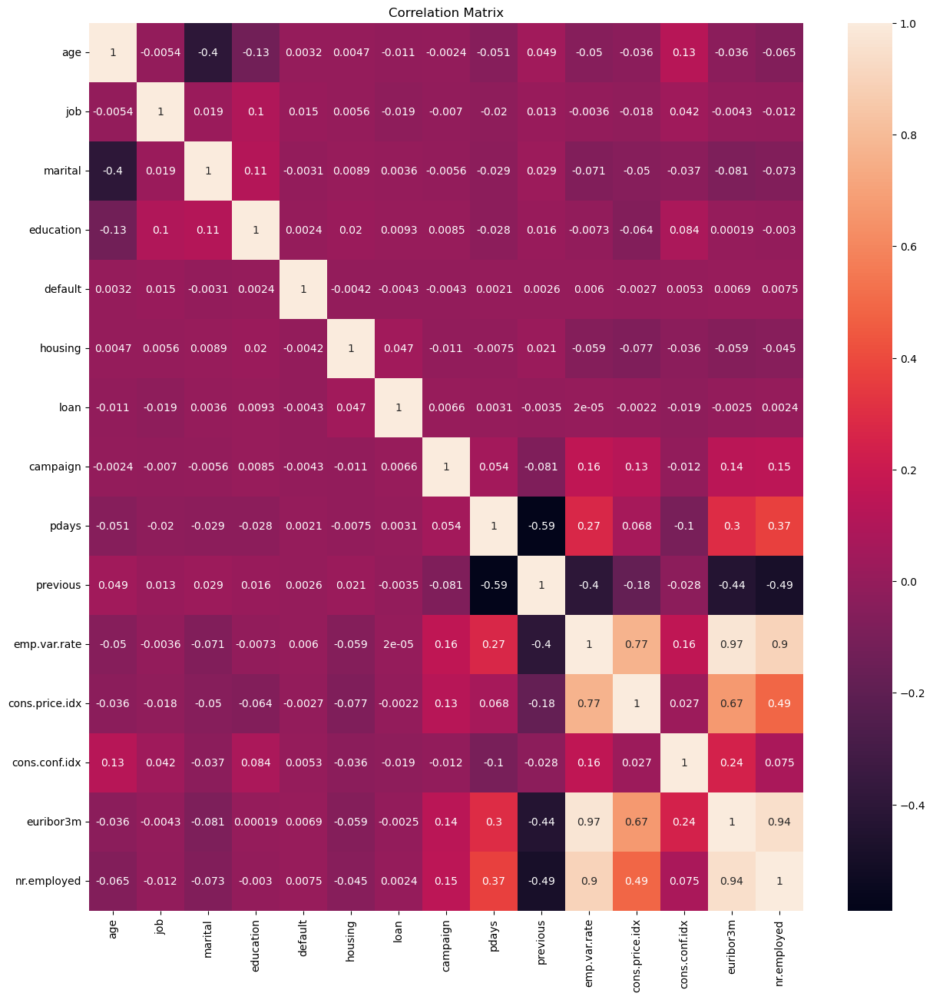

In [55]:
# Explore  correlation
#multi variate analysis
plt.figure(figsize=(15,15)) #To set canvas 
sns.heatmap(data.drop('TermDeposit_yes',axis=1).corr(),annot=True)
plt.title('Correlation Matrix')
plt.show()

In [18]:
# Identify highly correlated columns
# Compute the correlation matrix
correlation_matrix = data.corr()
highly_correlated_features = set()
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.9:  # You can adjust the correlation threshold as per your requirement
            colname_i = correlation_matrix.columns[i]
            colname_j = correlation_matrix.columns[j]
            highly_correlated_features.add(colname_i)
            highly_correlated_features.add(colname_j)

In [19]:
 highly_correlated_features

{'emp.var.rate', 'euribor3m', 'nr.employed'}

In [20]:
# Drop one highly correlated column at a time
data.drop(['nr.employed'], axis=1, inplace=True)

In [41]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30488 entries, 0 to 41187
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   age              30488 non-null  int64  
 1   job              30488 non-null  int32  
 2   marital          30488 non-null  int32  
 3   education        30488 non-null  int32  
 4   default          30488 non-null  int32  
 5   housing          30488 non-null  int32  
 6   loan             30488 non-null  int32  
 7   campaign         30488 non-null  int64  
 8   pdays            30488 non-null  int64  
 9   previous         30488 non-null  int64  
 10  emp.var.rate     30488 non-null  float64
 11  cons.price.idx   30488 non-null  float64
 12  cons.conf.idx    30488 non-null  float64
 13  euribor3m        30488 non-null  float64
 14  TermDeposit_yes  30488 non-null  uint8  
dtypes: float64(4), int32(6), int64(4), uint8(1)
memory usage: 2.8 MB


In [21]:
data.drop(['euribor3m'], axis=1, inplace=True)

In [22]:
duplicate = data[data.duplicated()]
print("Duplicate Rows :")
duplicate

Duplicate Rows :


,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,y_yes
11,25,7,2,3,0,1,0,1,999,0,1.1,93.994,-36.4,0
16,35,1,1,1,0,1,0,1,999,0,1.1,93.994,-36.4,0
104,52,0,0,6,0,0,0,1,999,0,1.1,93.994,-36.4,0
220,35,0,1,3,0,1,0,2,999,0,1.1,93.994,-36.4,0
226,42,9,1,6,0,0,0,2,999,0,1.1,93.994,-36.4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40806,35,9,1,5,0,1,0,1,999,2,-1.1,94.199,-37.5,0
40840,32,0,2,6,0,1,0,4,999,0,-1.1,94.199,-37.5,0
40852,34,0,1,6,0,0,1,3,999,0,-1.1,94.199,-37.5,1
41172,31,0,2,6,0,1,0,1,999,0,-1.1,94.767,-50.8,1


In [23]:
## checking the duplicate rows
data.duplicated().sum()

4732

In [24]:
data.drop_duplicates(inplace=True)

In [182]:
## checking the duplicate rows
data.duplicated().sum()

0

In [66]:
## checking the constant features in numerical 
## if the standard deviation of any feature is 0,
#that means we have constant feature,and we should remove.
data.describe()

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,TermDeposit_yes
count,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000
mean,39.499418,3.809986,1.178483,3.802842,0.000116,0.539059,0.175843,2.686520,948.570547,0.222395,-0.180490,93.511776,-40.704294,0.146956
std,10.659865,3.591184,0.633330,1.996938,0.010792,0.498482,0.380694,2.896164,218.028800,0.557685,1.636969,0.602002,4.888113,0.354069
min,17.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.000000
25%,32.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,1.000000,999.000000,0.000000,-1.800000,92.963000,-42.700000,0.000000
50%,37.000000,3.000000,1.000000,3.000000,0.000000,1.000000,0.000000,2.000000,999.000000,0.000000,-0.100000,93.444000,-41.800000,0.000000
75%,46.000000,7.000000,2.000000,6.000000,0.000000,1.000000,0.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,0.000000
max,95.000000,10.000000,2.000000,6.000000,1.000000,1.000000,1.000000,43.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,1.000000


In [48]:
# Model Creation

# Steps for creating model
Step1 --Create X and y-->Independent and dependent variable
Step 2 -- Any feature transformation method based on 
type of algorithm used.
Step 3 -- Creating training and testing data.

In training data the applied algorithm will find the
coefficients and use this equation to predict inputs 
from testing data.
Finally we will compare actual testing and predicted
testing values and analyze the performance of model.


In [26]:
data

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,y_yes
0,56,3,1,0,0,0,0,1,999,0,1.1,93.994,-36.4,0
2,37,7,1,3,0,1,0,1,999,0,1.1,93.994,-36.4,0
3,40,0,1,1,0,0,0,1,999,0,1.1,93.994,-36.4,0
4,56,7,1,3,0,0,1,1,999,0,1.1,93.994,-36.4,0
6,59,0,1,5,0,0,0,1,999,0,1.1,93.994,-36.4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,5,1,5,0,1,0,1,999,0,-1.1,94.767,-50.8,1
41184,46,1,1,5,0,0,0,1,999,0,-1.1,94.767,-50.8,0
41185,56,5,1,6,0,1,0,2,999,0,-1.1,94.767,-50.8,0
41186,44,9,1,5,0,0,0,1,999,0,-1.1,94.767,-50.8,1


In [28]:
## Renaming the Target Variable

# Rename the column
data.rename(columns={'y_yes': 'TermDeposit'}, inplace=True)

In [29]:
## Defining X and y and creating dependent and independent variables

X = data.drop(columns = ['TermDeposit']) ## independent variable
y = data['TermDeposit'] ## Dependent or target variable or the variable which we have to predict

In [68]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 25756 entries, 0 to 41187
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   age              25756 non-null  int64  
 1   job              25756 non-null  int32  
 2   marital          25756 non-null  int32  
 3   education        25756 non-null  int32  
 4   default          25756 non-null  int32  
 5   housing          25756 non-null  int32  
 6   loan             25756 non-null  int32  
 7   campaign         25756 non-null  int64  
 8   pdays            25756 non-null  int64  
 9   previous         25756 non-null  int64  
 10  emp.var.rate     25756 non-null  float64
 11  cons.price.idx   25756 non-null  float64
 12  cons.conf.idx    25756 non-null  float64
 13  TermDeposit_yes  25756 non-null  uint8  
dtypes: float64(3), int32(6), int64(4), uint8(1)
memory usage: 2.2 MB


# Why we need scaling?
Scaling is needed to make sure all numerical features have same magnitude.As 
if we pass varying magnitude to the algorithm,high chances are there algorithm will give 
importance to feature which have high magnitude.And leave the feature with lower magitude 
may be that feature will be more important.

In [30]:
## scaling the data 
from sklearn.preprocessing import StandardScaler 
scaler = StandardScaler()## object creation
X_scaled = scaler.fit_transform(X)# scaling independent variables

In [55]:
#fit--To fit the data
#fit_transform--First fit the data and then apply transformation
#transform

In [70]:
X_scaled #scaled data

array([[ 1.54794662e+00, -2.25552814e-01, -2.81821620e-01,
        -1.90437319e+00, -1.07931127e-02, -1.08142239e+00,
        -4.61909453e-01, -5.82340019e-01,  2.31301701e-01,
        -3.98789961e-01,  7.82247292e-01,  8.01049607e-01,
         8.80580673e-01],
       [-2.34474455e-01,  8.88307464e-01, -2.81821620e-01,
        -4.02044277e-01, -1.07931127e-02,  9.24708057e-01,
        -4.61909453e-01, -5.82340019e-01,  2.31301701e-01,
        -3.98789961e-01,  7.82247292e-01,  8.01049607e-01,
         8.80580673e-01],
       [ 4.69604527e-02, -1.06094802e+00, -2.81821620e-01,
        -1.40359688e+00, -1.07931127e-02, -1.08142239e+00,
        -4.61909453e-01, -5.82340019e-01,  2.31301701e-01,
        -3.98789961e-01,  7.82247292e-01,  8.01049607e-01,
         8.80580673e-01],
       [ 1.54794662e+00,  8.88307464e-01, -2.81821620e-01,
        -4.02044277e-01, -1.07931127e-02, -1.08142239e+00,
         2.16492647e+00, -5.82340019e-01,  2.31301701e-01,
        -3.98789961e-01,  7.82247292e

In [57]:
data.head()

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,TermDeposit_yes
0,56,3,1,0,0,0,0,1,999,0,1.1,93.994,-36.4,0
2,37,7,1,3,0,1,0,1,999,0,1.1,93.994,-36.4,0
3,40,0,1,1,0,0,0,1,999,0,1.1,93.994,-36.4,0
4,56,7,1,3,0,0,1,1,999,0,1.1,93.994,-36.4,0
6,59,0,1,5,0,0,0,1,999,0,1.1,93.994,-36.4,0


In [58]:
X

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx
0,56,3,1,0,0,0,0,1,999,0,1.1,93.994,-36.4
2,37,7,1,3,0,1,0,1,999,0,1.1,93.994,-36.4
3,40,0,1,1,0,0,0,1,999,0,1.1,93.994,-36.4
4,56,7,1,3,0,0,1,1,999,0,1.1,93.994,-36.4
6,59,0,1,5,0,0,0,1,999,0,1.1,93.994,-36.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,5,1,5,0,1,0,1,999,0,-1.1,94.767,-50.8
41184,46,1,1,5,0,0,0,1,999,0,-1.1,94.767,-50.8
41185,56,5,1,6,0,1,0,2,999,0,-1.1,94.767,-50.8
41186,44,9,1,5,0,0,0,1,999,0,-1.1,94.767,-50.8


In [71]:
## creating training and testing data
from sklearn.model_selection import train_test_split
#splitting data into train and test
x_train,x_test,y_train,y_test = train_test_split (X_scaled,y, test_size= 0.2,random_state = 42)


In [72]:
##Model creation
from sklearn.linear_model import LogisticRegression
log_reg = LogisticRegression()#object creation of logistic regression
    
log_reg.fit(x_train,y_train)#training model with training data


LogisticRegression()

In [73]:
import sys
np.set_printoptions(threshold=sys.maxsize)

In [74]:
y_train_pre=log_reg.predict(x_train)# predicting y_train  

In [75]:
y_train_pre

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [65]:
# Let's see how well our model performs on the test data set.

In [76]:
y_pred = log_reg.predict(x_test) # testing model 
y_pred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [77]:
y_train.shape # to know the shape of y_train (rows and columns)

(20604,)

In [78]:
y_pred.shape # to know the shape of y_pred (rows and columns )

(5152,)

In [79]:
# Evaluate the model's performance
## calculating accuracy
from sklearn.metrics import accuracy_score,confusion_matrix,precision_score,recall_score,f1_score,classification_report
accuracy = accuracy_score(y_train,y_train_pre)# model traning accuracy  
accuracy

0.8707532517957678

In [80]:
test_accuracy=accuracy_score(y_test,y_pred)
test_accuracy

0.8649068322981367

In [81]:
# Precison on testing
Precision = precision_score(y_test,y_pred)# the number of true positive divided by the total number of positive prediction
Precision

0.6854460093896714

In [82]:
# Recall on testing
Recall = recall_score(y_test,y_pred)# the total number of positive results how many positives were correctly predicted by the model.
Recall

0.18838709677419355

In [83]:
# F1 Score
F1_Score = f1_score(y_test,y_pred)# when precision and recall both are important
F1_Score

0.2955465587044534

In [84]:
# Area Under Curve
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, y_pred)
auc

0.5865399043386618

In [85]:
cm=confusion_matrix(y_test,y_pred)
cm

array([[4310,   67],
       [ 629,  146]], dtype=int64)

In [86]:
##confusion matrix
pd.crosstab(y_test, y_pred)

col_0,0,1
TermDeposit_yes,,
0,4310,67
1,629,146


In [87]:
report=classification_report(y_test, y_pred)# it will give precision,recall,f1 scores and accuracy  
print(report)

              precision    recall  f1-score   support

           0       0.87      0.98      0.93      4377
           1       0.69      0.19      0.30       775

    accuracy                           0.86      5152
   macro avg       0.78      0.59      0.61      5152
weighted avg       0.84      0.86      0.83      5152



In [78]:
# ROC PLOT

In [88]:
## Prediciting the probabilities of class 1
probs=log_reg.predict_proba(x_test)[:,1]

In [89]:
probs#probabilities of class 1


array([0.0570492 , 0.04939355, 0.08956035, 0.07830283, 0.07290982,
       0.02708221, 0.08871178, 0.04546615, 0.37515527, 0.04493227,
       0.03877397, 0.06771213, 0.06825971, 0.04653587, 0.10393447,
       0.08765153, 0.09712029, 0.03230859, 0.05187532, 0.1654306 ,
       0.17432168, 0.03704657, 0.0737632 , 0.1176075 , 0.27265499,
       0.12527282, 0.11458248, 0.18119141, 0.10698737, 0.13938748,
       0.07036338, 0.09034285, 0.11243268, 0.02723933, 0.0567281 ,
       0.08500833, 0.07975902, 0.10379906, 0.05610238, 0.07430672,
       0.03872963, 0.1026553 , 0.04181794, 0.04560419, 0.43419164,
       0.08449922, 0.06744892, 0.18236844, 0.33659854, 0.09509368,
       0.04607835, 0.04603439, 0.20038295, 0.74010188, 0.07405931,
       0.05169555, 0.14464359, 0.04803245, 0.05971387, 0.11202173,
       0.06061363, 0.23219443, 0.21038833, 0.09171872, 0.06594971,
       0.03911145, 0.07014501, 0.24863241, 0.08871381, 0.14448554,
       0.03868426, 0.7411696 , 0.03882551, 0.03711673, 0.20084

In [90]:
## Defining the threshold limit
def predict_threshold (model,X_test,thresholds):
    return np.where(model.predict_proba(X_test)[:,1]>thresholds,1,0)#checking where probability of class 1 is  greater than threshold

In [91]:
import numpy as np
from sklearn.metrics import confusion_matrix
for thr in np.arange(0,1.0,0.1):# it will create matrix /array from range 0 to 1 with step 0.1
    y_predict = predict_threshold(log_reg,x_test,thr)# it will check result  for  each threshold from 0 to 0.1
    print("Threshold :",thr)#printing threshold
    print(confusion_matrix(y_test,y_pred))# confusion matrix for each prediction

Threshold : 0.0
[[4310   67]
 [ 629  146]]
Threshold : 0.1
[[4310   67]
 [ 629  146]]
Threshold : 0.2
[[4310   67]
 [ 629  146]]
Threshold : 0.30000000000000004
[[4310   67]
 [ 629  146]]
Threshold : 0.4
[[4310   67]
 [ 629  146]]
Threshold : 0.5
[[4310   67]
 [ 629  146]]
Threshold : 0.6000000000000001
[[4310   67]
 [ 629  146]]
Threshold : 0.7000000000000001
[[4310   67]
 [ 629  146]]
Threshold : 0.8
[[4310   67]
 [ 629  146]]
Threshold : 0.9
[[4310   67]
 [ 629  146]]


In [92]:
## visualizing the roc plot
def plot_roc_curve(fpr, tpr):# function to plot roc curve
    plt.plot(fpr, tpr, color='orange', label='ROC')#line plot between fpr and tpr
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')# assigning name to  x axis
    plt.ylabel('True Positive Rate')# assigning name to y axis
    plt.title('Receiver Operating Characteristic (ROC) Curve')#assigning name to curve  
    plt.legend()#area describing the elements of the graph
    plt.show()#to show graph without location

In [93]:
from sklearn.metrics import roc_auc_score,roc_curve ## used to compare multiple models
auc = roc_auc_score(y_test, probs) #roc curve 
print('AUC: %.2f' % auc)

AUC: 0.76


In [94]:
fpr, tpr, thresholds = roc_curve(y_test, probs)
# it will return 
#Increasing false positive rates such that element i is the false positive rate of predictions with score >= thresholds[i].
#Increasing true positive rates such that element i is the true positive rate of predictions with score >= thresholds[i].
#Decreasing thresholds on the decision function used to compute fpr and tpr

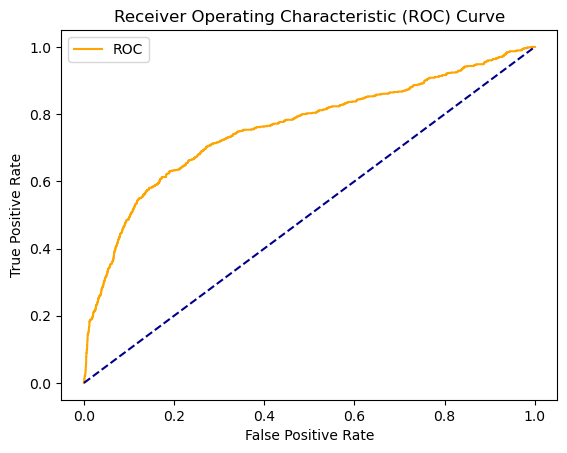

In [95]:
import matplotlib.pyplot as plt
plot_roc_curve(fpr, tpr)#plotting ruc curve

# Model 2 - Support Vector Machine

In [107]:
##importing the libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [108]:
#Loading the data
datasvm = pd.read_csv('bank-additional-full.csv',sep=";")

# Exploratory Data Analysis

# Data Pre-processing and Feature Engineering

In [65]:
# Quick summary of data
datasvm.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

In [66]:
# Statistical information of the data
datasvm.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,93.575664,-40.502600,3.621291,5167.035911
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,0.578840,4.628198,1.734447,72.251528
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


In [109]:
datasvm.describe(include='O')

,job,marital,education,default,housing,loan,contact,month,day_of_week,poutcome,y
count,41188,41188,41188,41188,41188,41188,41188,41188,41188,41188,41188
unique,12,4,8,3,3,3,2,10,5,3,2
top,admin.,married,university.degree,no,yes,no,cellular,may,thu,nonexistent,no
freq,10422,24928,12168,32588,21576,33950,26144,13769,8623,35563,36548


In [68]:
## Checking missing values

datasvm.isnull().sum()

age               0
job               0
marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
y                 0
dtype: int64

In [7]:
datasvm.shape

(41188, 21)

In [110]:
# Check for "unknown" values in each column
for column in datasvm.columns:
    unknown_count = datasvm[column].loc[datasvm[column] == 'unknown'].count()
    if unknown_count > 0:
        print(f"Column '{column}' has {unknown_count} 'unknown' values.")

Column 'job' has 330 'unknown' values.
Column 'marital' has 80 'unknown' values.
Column 'education' has 1731 'unknown' values.
Column 'default' has 8597 'unknown' values.
Column 'housing' has 990 'unknown' values.
Column 'loan' has 990 'unknown' values.


In [111]:
num_rows_before = len(datasvm)
print(f"Number of rows before dropping 'unknown' values: {num_rows_before}")

Number of rows before dropping 'unknown' values: 41188


In [112]:
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)

In [113]:
# 'datasvm' is the DataFrame containing the columns 'job', 'marital', 'education', 'default', 'housing', 'loan'
columns_to_check = ['job', 'marital', 'education', 'default', 'housing', 'loan']

for column in columns_to_check:
    unique_values = datasvm[column].unique()
    print(f"{column} unique values:")
    for value in unique_values:
        print(value)
    print()

job unique values:
housemaid
services
admin.
blue-collar
technician
retired
management
unemployed
self-employed
unknown
entrepreneur
student

marital unique values:
married
single
divorced
unknown

education unique values:
basic.4y
high.school
basic.6y
basic.9y
professional.course
unknown
university.degree
illiterate

default unique values:
no
unknown
yes

housing unique values:
no
yes
unknown

loan unique values:
no
yes
unknown



In [114]:
# Replace "unknown" values with NaN
datasvm.replace('unknown', pd.NA, inplace=True)

In [115]:
# Drop rows with NaN values
datasvm.dropna(inplace=True)
# Now the dataset does not contain rows with "unknown" values

In [116]:
# Get the number of rows before dropping NaN values
num_rows_after = len(datasvm)
print(f"Number of rows after dropping 'unknown' values: {num_rows_after}")

Number of rows after dropping 'unknown' values: 30488


# Dropping columns

- **Duration :**-It is typically not known beforehand whether a customer will subscribe to the bank's product or service, and the duration of the call itself can heavily influence the outcome. By removing this column, one prevents the model from relying on a variable that would not be available in a real-time scenario, thus avoiding potential bias. 
- **'contact', 'month', 'day_of_week':** These variables may not provide significant predictive power or may introduce noise to the model. In such cases, it is in the best interests to remove them to simplify the model and improve interpretability.
- **'poutcome':** This column represents the outcome of the previous marketing campaign for the same client.Removing it can help avoid relying on information that may not be relevant or reliable.


In [117]:
datasvm = datasvm.drop(['duration', 'contact', 'month', 'day_of_week', 'poutcome'], axis=1)

In [107]:
datasvm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30488 entries, 0 to 41187
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             30488 non-null  int64  
 1   job             30488 non-null  object 
 2   marital         30488 non-null  object 
 3   education       30488 non-null  object 
 4   default         30488 non-null  object 
 5   housing         30488 non-null  object 
 6   loan            30488 non-null  object 
 7   campaign        30488 non-null  int64  
 8   pdays           30488 non-null  int64  
 9   previous        30488 non-null  int64  
 10  emp.var.rate    30488 non-null  float64
 11  cons.price.idx  30488 non-null  float64
 12  cons.conf.idx   30488 non-null  float64
 13  euribor3m       30488 non-null  float64
 14  nr.employed     30488 non-null  float64
 15  y               30488 non-null  object 
dtypes: float64(5), int64(4), object(7)
memory usage: 4.0+ MB


# Convert categorical variables to numerical using label encoding

In [118]:
# Get data types of each column
data_types = datasvm.dtypes

# Identify categorical columns (assuming they have 'object' data type)
categorical_columns = data_types[data_types == 'object'].index.tolist()

In [119]:
for column in categorical_columns:
    print(f"Column: {column}")
    print(datasvm[column].unique())  # Display unique categories in the column
    print("------------------------")

Column: job
['housemaid' 'services' 'admin.' 'technician' 'blue-collar' 'unemployed'
 'retired' 'entrepreneur' 'management' 'student' 'self-employed']
------------------------
Column: marital
['married' 'single' 'divorced']
------------------------
Column: education
['basic.4y' 'high.school' 'basic.6y' 'professional.course' 'basic.9y'
 'university.degree' 'illiterate']
------------------------
Column: default
['no' 'yes']
------------------------
Column: housing
['no' 'yes']
------------------------
Column: loan
['no' 'yes']
------------------------
Column: y
['no' 'yes']
------------------------


In [120]:
from sklearn.preprocessing import LabelEncoder
lc = LabelEncoder()
datasvm[categorical_columns] = datasvm[categorical_columns].apply(lc.fit_transform)

In [80]:
datasvm.head()

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,3,1,0,0,0,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,0
2,37,7,1,3,0,1,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,0
3,40,0,1,1,0,0,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,0
4,56,7,1,3,0,0,1,1,999,0,1.1,93.994,-36.4,4.857,5191.0,0
6,59,0,1,5,0,0,0,1,999,0,1.1,93.994,-36.4,4.857,5191.0,0


In [121]:
## Renaming the Target Variable

# Rename the column
datasvm.rename(columns={'y': 'TermDeposit'}, inplace=True)


In [16]:
datasvm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30488 entries, 0 to 41187
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             30488 non-null  int64  
 1   job             30488 non-null  int32  
 2   marital         30488 non-null  int32  
 3   education       30488 non-null  int32  
 4   default         30488 non-null  int32  
 5   housing         30488 non-null  int32  
 6   loan            30488 non-null  int32  
 7   campaign        30488 non-null  int64  
 8   pdays           30488 non-null  int64  
 9   previous        30488 non-null  int64  
 10  emp.var.rate    30488 non-null  float64
 11  cons.price.idx  30488 non-null  float64
 12  cons.conf.idx   30488 non-null  float64
 13  euribor3m       30488 non-null  float64
 14  nr.employed     30488 non-null  float64
 15  TermDeposit     30488 non-null  int32  
dtypes: float64(5), int32(7), int64(4)
memory usage: 3.1 MB


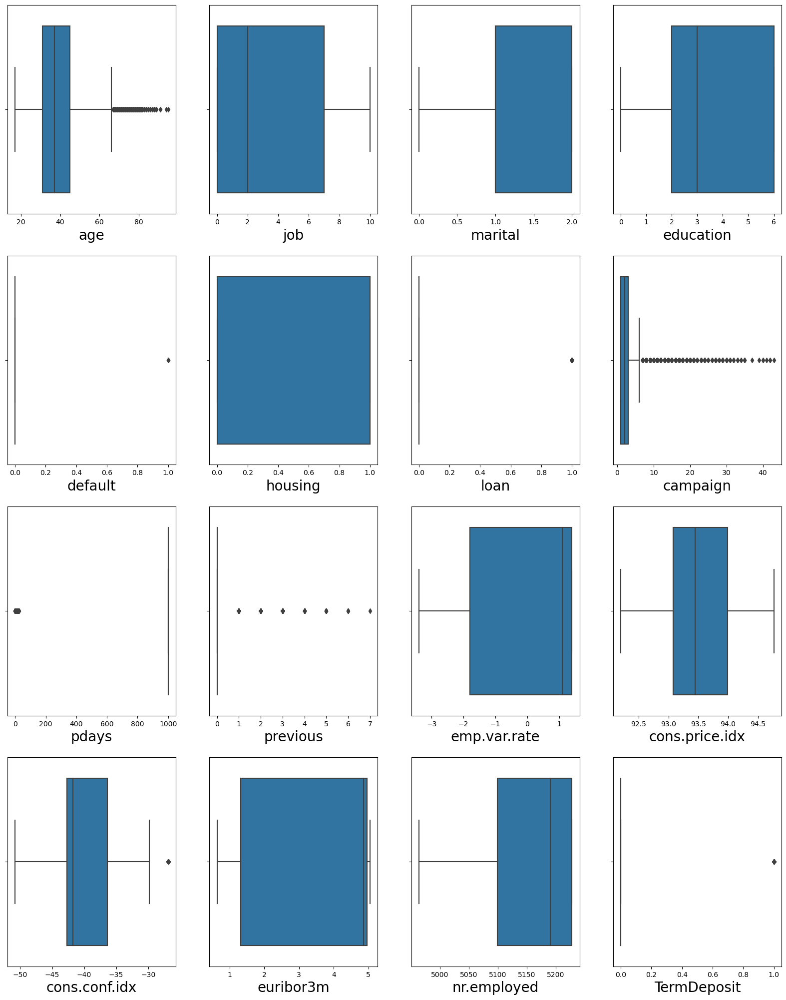

In [82]:
# Checking for outliers
# let's see how data is distributed for every column
import warnings
warnings.filterwarnings('ignore')
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in datasvm:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.boxplot(datasvm[column]) 
        plt.xlabel(column,fontsize=20)
        
    plotnumber+=1
plt.show()

In [122]:
numerical_cols = ['age', 'campaign', 'pdays', 'previous', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed']

In [123]:
def calculate_outlier_percentage(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    outlier_threshold = 1.5 * IQR

    num_outliers = ((column < Q1 - outlier_threshold) | (column > Q3 + outlier_threshold)).sum()
    percentage_outliers = (num_outliers / len(column)) * 100
    return percentage_outliers

In [124]:
# Calculate the percentage of outliers for each numerical column
outlier_percentages = {column: calculate_outlier_percentage(datasvm[column]) for column in numerical_cols}
print("Percentage of outliers in each numerical feature:")
print(outlier_percentages)

Percentage of outliers in each numerical feature:
{'age': 1.5022303857255315, 'campaign': 5.4939648386250335, 'pdays': 4.296772500655996, 'previous': 15.258462345840988, 'emp.var.rate': 0.0, 'cons.price.idx': 0.0, 'cons.conf.idx': 1.2988716872212016, 'euribor3m': 0.0, 'nr.employed': 0.0}


In [125]:
def remove_outliers_zscore(dataframe, threshold=3):
  
    # Create an empty DataFrame to store the filtered data
    filtered_data = pd.DataFrame()

    # Loop through all columns in the DataFrame
    for column in dataframe.columns:
        
        # Calculate the Z-score for the current column
        z_scores = (dataframe[column] - dataframe[column].mean()) / dataframe[column].std()
# Filter out the rows with Z-scores above the threshold for the current column
        filtered_data[column] = dataframe[abs(z_scores) < threshold][column]
    
    return filtered_data

# Example usage:
# Assuming you have a DataFrame called 'df' containing all your data
datasvm_cleaned = remove_outliers_zscore(datasvm)


In [126]:
# Calculate the percentage of outliers for each numerical column
outlier_percentages = {column: calculate_outlier_percentage(datasvm_cleaned[column]) for column in numerical_cols}
print("Percentage of outliers in each numerical feature:")
print(outlier_percentages)

Percentage of outliers in each numerical feature:
{'age': 0.4046166091801539, 'campaign': 3.555319713451844, 'pdays': 0.0, 'previous': 12.171663571239055, 'emp.var.rate': 0.0, 'cons.price.idx': 0.0, 'cons.conf.idx': 1.177368002122579, 'euribor3m': 0.0, 'nr.employed': 0.0}


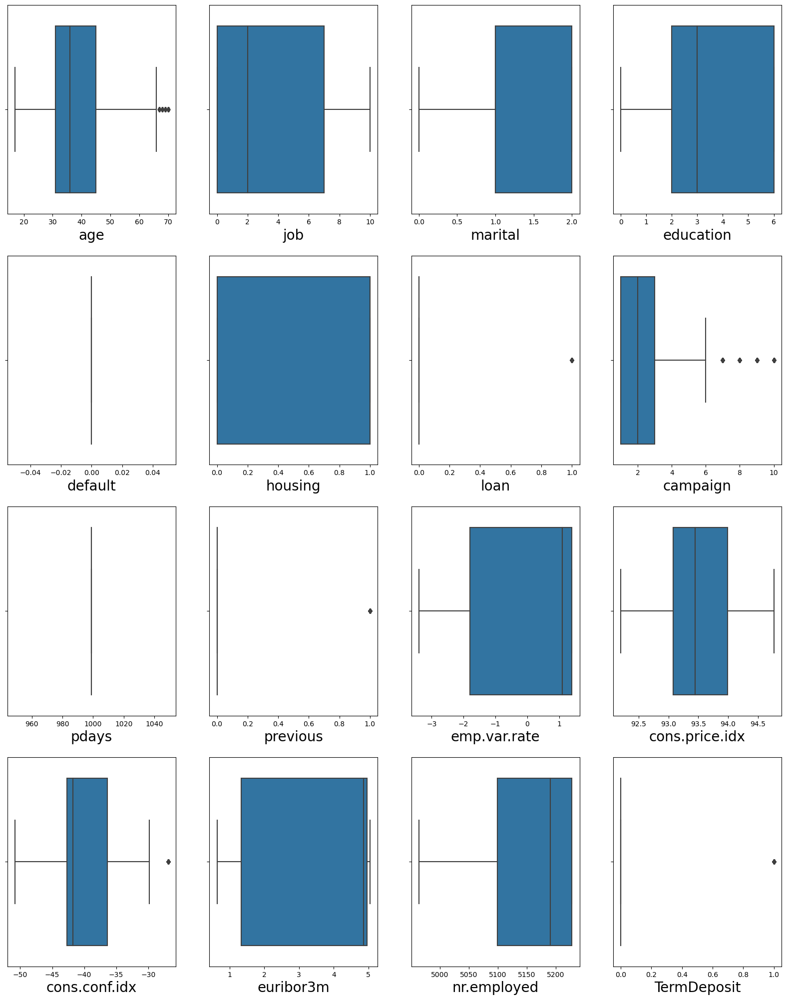

In [23]:
# Checking for outliers
# let's see how data is distributed for every column
import warnings
warnings.filterwarnings('ignore')
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in datasvm:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.boxplot(datasvm_cleaned[column]) 
        plt.xlabel(column,fontsize=20)
        
    plotnumber+=1
plt.show()

In [27]:
datasvm.describe()


,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,TermDeposit
count,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000,30488.000000
mean,39.030012,3.716708,1.193191,3.842791,0.000098,0.541885,0.156389,2.521451,956.332295,0.194273,-0.071510,93.523311,-40.602263,3.459938,5160.813409,0.126574
std,10.333529,3.612755,0.623663,1.988911,0.009919,0.498251,0.363230,2.720150,201.373292,0.522788,1.610399,0.585374,4.789249,1.777231,75.158065,0.332501
min,17.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000,0.000000
25%,31.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.313000,5099.100000,0.000000
50%,37.000000,2.000000,1.000000,3.000000,0.000000,1.000000,0.000000,2.000000,999.000000,0.000000,1.100000,93.444000,-41.800000,4.856000,5191.000000,0.000000
75%,45.000000,7.000000,2.000000,6.000000,0.000000,1.000000,0.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000,0.000000
max,95.000000,10.000000,2.000000,6.000000,1.000000,1.000000,1.000000,43.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000,1.000000


In [127]:
import pandas as pd

# 'datasvm' is  DataFrame

unique_value_counts = datasvm.nunique()

print("Count of unique values in each column:")
print(unique_value_counts)

Count of unique values in each column:
age                76
job                11
marital             3
education           7
default             2
housing             2
loan                2
campaign           41
pdays              26
previous            8
emp.var.rate       10
cons.price.idx     26
cons.conf.idx      26
euribor3m         314
nr.employed        11
TermDeposit         2
dtype: int64


In [128]:
# Get the unique value counts for the selected column
pd.set_option('display.max_rows', None)
value_counts = datasvm['age'].value_counts()
value_counts

31    1643
32    1555
33    1524
30    1441
34    1431
35    1399
36    1391
29    1263
37    1140
39    1035
38    1033
41     906
28     809
40     807
42     793
43     741
27     699
44     677
48     670
45     664
46     659
47     600
26     599
50     552
49     516
52     506
25     500
53     469
51     460
54     432
56     407
55     400
58     383
24     375
57     372
59     266
23     205
60     156
22     115
21      84
61      64
20      47
71      46
64      45
62      42
63      41
70      41
66      40
65      36
69      30
68      30
74      29
72      28
73      28
76      28
80      26
88      22
67      21
19      21
75      20
78      20
81      16
83      15
18      15
82      13
77      12
79      12
85       7
84       4
86       3
17       2
91       2
89       2
95       1
87       1
94       1
Name: age, dtype: int64

In [129]:
# Get the unique value counts for the selected column
value_counts = datasvm['pdays'].value_counts()
value_counts

999    29178
3        381
6        363
4        102
2         53
9         53
7         50
12        50
5         43
10        40
13        33
11        25
15        22
1         21
14        17
0         14
8         13
16         8
17         6
18         5
22         3
19         3
21         2
25         1
26         1
27         1
Name: pdays, dtype: int64

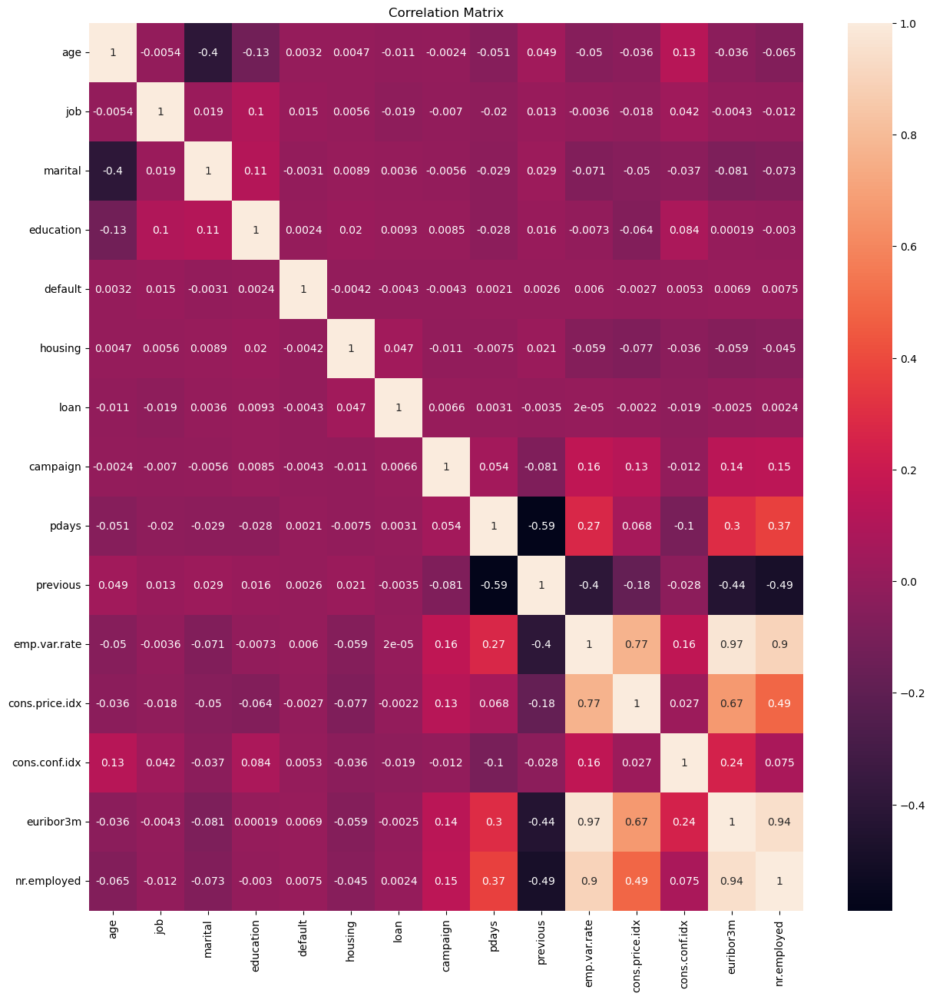

In [130]:
# Explore  correlation
#multi variate analysis
plt.figure(figsize=(15,15)) #To set canvas 
sns.heatmap(datasvm.drop('TermDeposit',axis=1).corr(),annot=True)
plt.title('Correlation Matrix')
plt.show()

In [131]:
# Identify highly correlated columns
# Compute the correlation matrix
correlation_matrix = datasvm.corr()
highly_correlated_features = set()
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.9:  # You can adjust the correlation threshold as per your requirement
            colname_i = correlation_matrix.columns[i]
            colname_j = correlation_matrix.columns[j]
            highly_correlated_features.add(colname_i)
            highly_correlated_features.add(colname_j)
           

In [132]:
highly_correlated_features

{'emp.var.rate', 'euribor3m', 'nr.employed'}

In [133]:
# Drop one highly correlated column at a time
datasvm.drop(['nr.employed'], axis=1, inplace=True)
datasvm.drop(['euribor3m'], axis=1, inplace=True)

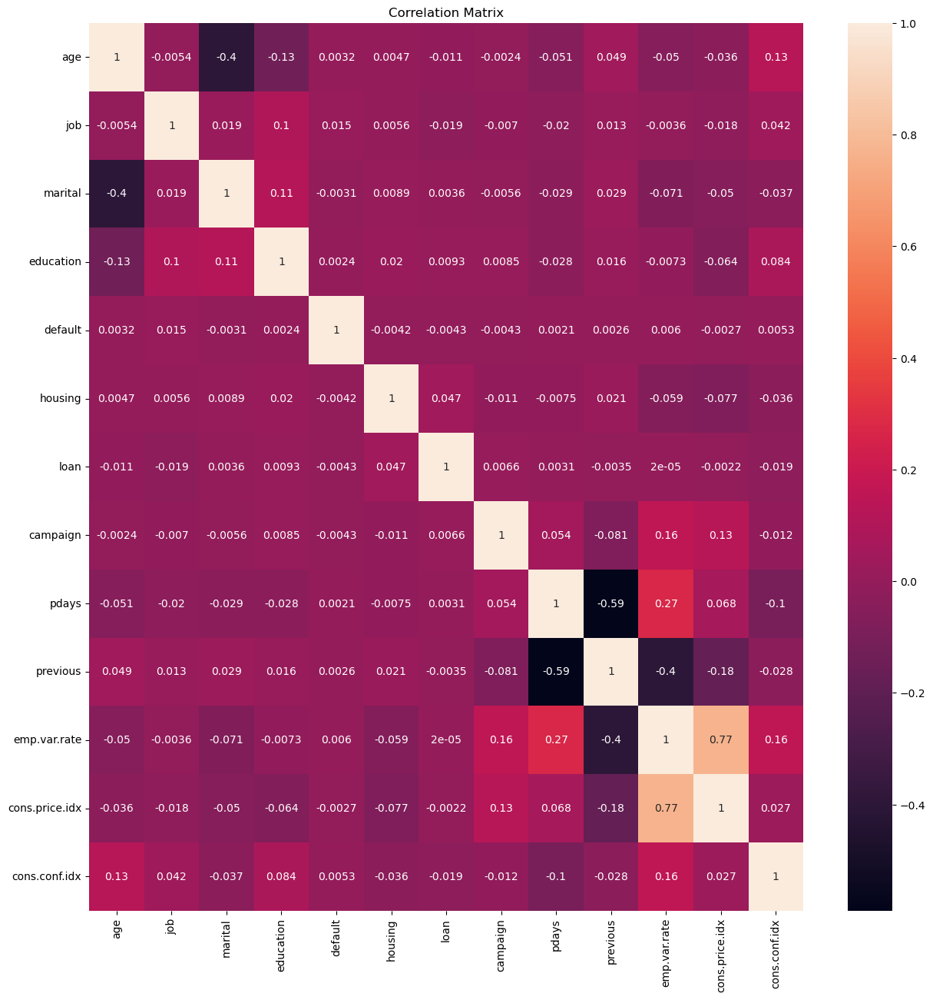

In [134]:
# Explore  correlation
#multi variate analysis
plt.figure(figsize=(15,15)) #To set canvas 
sns.heatmap(datasvm.drop('TermDeposit',axis=1).corr(),annot=True)
plt.title('Correlation Matrix')
plt.show()

In [135]:
duplicate = datasvm[datasvm.duplicated()]
print("Duplicate Rows :")
duplicate

Duplicate Rows :


,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,TermDeposit
11,25,7,2,3,0,1,0,1,999,0,1.1,93.994,-36.4,0
16,35,1,1,1,0,1,0,1,999,0,1.1,93.994,-36.4,0
104,52,0,0,6,0,0,0,1,999,0,1.1,93.994,-36.4,0
220,35,0,1,3,0,1,0,2,999,0,1.1,93.994,-36.4,0
226,42,9,1,6,0,0,0,2,999,0,1.1,93.994,-36.4,0
260,33,0,1,3,0,0,1,1,999,0,1.1,93.994,-36.4,0
276,34,7,1,3,0,0,0,1,999,0,1.1,93.994,-36.4,0
331,36,1,1,2,0,1,0,2,999,0,1.1,93.994,-36.4,0
370,37,1,1,2,0,0,0,1,999,0,1.1,93.994,-36.4,0
472,31,0,0,3,0,0,0,1,999,0,1.1,93.994,-36.4,0


In [136]:
## checking the duplicate rows
datasvm.duplicated().sum()

4732

In [137]:
datasvm.drop_duplicates(inplace=True)


In [138]:
## checking the duplicate rows
datasvm.duplicated().sum()

0

In [132]:
datasvm.describe()

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,TermDeposit
count,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000
mean,39.499418,3.809986,1.178483,3.802842,0.000116,0.539059,0.175843,2.686520,948.570547,0.222395,-0.180490,93.511776,-40.704294,0.146956
std,10.659865,3.591184,0.633330,1.996938,0.010792,0.498482,0.380694,2.896164,218.028800,0.557685,1.636969,0.602002,4.888113,0.354069
min,17.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.000000
25%,32.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,1.000000,999.000000,0.000000,-1.800000,92.963000,-42.700000,0.000000
50%,37.000000,3.000000,1.000000,3.000000,0.000000,1.000000,0.000000,2.000000,999.000000,0.000000,-0.100000,93.444000,-41.800000,0.000000
75%,46.000000,7.000000,2.000000,6.000000,0.000000,1.000000,0.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,0.000000
max,95.000000,10.000000,2.000000,6.000000,1.000000,1.000000,1.000000,43.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,1.000000


In [41]:
## checking the constant features in numerical 
## if the standard deviation of any feature is 0,
#that means we have constant feature,and we should remove.
datasvm.describe()

,age,job,marital,education,default,housing,loan,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,TermDeposit
count,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000,25756.000000
mean,39.499418,3.809986,1.178483,3.802842,0.000116,0.539059,0.175843,2.686520,948.570547,0.222395,-0.180490,93.511776,-40.704294,0.146956
std,10.659865,3.591184,0.633330,1.996938,0.010792,0.498482,0.380694,2.896164,218.028800,0.557685,1.636969,0.602002,4.888113,0.354069
min,17.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.000000
25%,32.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,1.000000,999.000000,0.000000,-1.800000,92.963000,-42.700000,0.000000
50%,37.000000,3.000000,1.000000,3.000000,0.000000,1.000000,0.000000,2.000000,999.000000,0.000000,-0.100000,93.444000,-41.800000,0.000000
75%,46.000000,7.000000,2.000000,6.000000,0.000000,1.000000,0.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,0.000000
max,95.000000,10.000000,2.000000,6.000000,1.000000,1.000000,1.000000,43.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,1.000000


In [139]:
# Identify continuous columns based on data types
continuous_columns = datasvm.select_dtypes(include=['float64', 'int64']).columns
print("Continuous columns:", continuous_columns)

Continuous columns: Index(['age', 'campaign', 'pdays', 'previous', 'emp.var.rate',
       'cons.price.idx', 'cons.conf.idx'],
      dtype='object')


In [291]:
# scaling
#fit--To fit the data
#fit_transform--First fit the data and then apply transformation
#transform

In [140]:
## Defining X and y and creating dependent and independent variables

X = datasvm.drop(columns = ['TermDeposit']) ## independent variable
y = datasvm['TermDeposit'] ## Dependent or target variable or the variable which we have to predict

In [141]:
## scaling the data 
from sklearn.preprocessing import StandardScaler 
scaler = StandardScaler()## object creation
X_scaled = scaler.fit_transform(X)# scaling independent variables

In [37]:
X_scaled

array([[ 1.64225272e+00, -1.98386006e-01, -3.09772710e-01,
        -1.93213934e+00, -9.92013375e-03, -1.08759349e+00,
        -4.30558970e-01, -5.59335247e-01,  2.11887111e-01,
        -3.71615904e-01,  7.27477456e-01,  8.04095102e-01,
         8.77451093e-01],
       [-1.96452253e-01,  9.08820538e-01, -3.09772710e-01,
        -4.23751656e-01, -9.92013375e-03,  9.19461187e-01,
        -4.30558970e-01, -5.59335247e-01,  2.11887111e-01,
        -3.71615904e-01,  7.27477456e-01,  8.04095102e-01,
         8.77451093e-01],
       [ 9.38695850e-02, -1.02879091e+00, -3.09772710e-01,
        -1.42934344e+00, -9.92013375e-03, -1.08759349e+00,
        -4.30558970e-01, -5.59335247e-01,  2.11887111e-01,
        -3.71615904e-01,  7.27477456e-01,  8.04095102e-01,
         8.77451093e-01],
       [ 1.64225272e+00,  9.08820538e-01, -3.09772710e-01,
        -4.23751656e-01, -9.92013375e-03, -1.08759349e+00,
         2.32256223e+00, -5.59335247e-01,  2.11887111e-01,
        -3.71615904e-01,  7.27477456e

In [295]:
# Model Creation

In [142]:
X.shape

(25756, 13)

In [143]:
y.shape

(25756,)

In [144]:
## creating training and testing data
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X, y,random_state=42)

In [145]:
from collections import Counter
print("Actual Classes",Counter(y))

Actual Classes Counter({0: 21971, 1: 3785})


In [146]:
from collections import Counter
print("Actual Classes",Counter(X))

Actual Classes Counter({'age': 1, 'job': 1, 'marital': 1, 'education': 1, 'default': 1, 'housing': 1, 'loan': 1, 'campaign': 1, 'pdays': 1, 'previous': 1, 'emp.var.rate': 1, 'cons.price.idx': 1, 'cons.conf.idx': 1})


In [147]:
## balancing the data
# !pip install imblearn
# !pip3...
# Install imblearn package - pip install imblearn
from imblearn.over_sampling import SMOTE
smote = SMOTE()

In [148]:
X_smote, y_smote = smote.fit_resample(X_train,y_train)

**Counter** is a container which keeps track to how many times equivalent values are added. Python counter class is a part of collections module and is a subclass of dictionary.

In [149]:
from collections import Counter
print("Actual Classes",Counter(y))
print("SMOTE Classes",Counter(y_smote))

Actual Classes Counter({0: 21971, 1: 3785})
SMOTE Classes Counter({0: 16490, 1: 16490})


In [150]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score

In [151]:
from sklearn.svm import SVC

In [152]:
# Support Vector Classifier Model

from sklearn.svm import SVC
svclassifier = SVC() ## base model with default parameters
svclassifier.fit(X_smote, y_smote)

SVC()

In [153]:
# Predict output for X_test

y_hat=svclassifier.predict(X_test)

In [154]:
## evaluating the model created
from sklearn.metrics import accuracy_score,classification_report,f1_score
acc=accuracy_score(y_test,y_hat)
acc

0.8624009939431588

In [155]:
# Calssification report measures the quality of predictions. True Positives, False Positives, True negatives and False Negatives 
# are used to predict the metrics of a classification report 

print(classification_report(y_test,y_hat))

              precision    recall  f1-score   support

           0       0.87      0.98      0.92      5481
           1       0.62      0.20      0.30       958

    accuracy                           0.86      6439
   macro avg       0.75      0.59      0.61      6439
weighted avg       0.84      0.86      0.83      6439



In [156]:
cm1=pd.crosstab(y_test,y_hat)
cm1

col_0,0,1
TermDeposit,,
0,5364,117
1,769,189


In [157]:
# F1 score considers both Precision and Recall for evaluating a model
f1=f1_score(y_test,y_hat)
f1

0.29905063291139244

In [158]:
## checking cross validation score
from sklearn.model_selection import cross_val_score
scores = cross_val_score(svclassifier,X,y,cv=3,scoring='f1')
print(scores)
print("Cross validation Score:",scores.mean())
print("Std :",scores.std())
#std of < 0.05 is good. 

[0.01416208 0.31323722 0.51480836]
Cross validation Score: 0.28073588698936075
Std : 0.20567600458938104


## GridSearch CV

In [159]:
from sklearn.model_selection import GridSearchCV
  
# defining parameter range
param_grid = {'C': [0.1, 1, 10, 100, 1000], 
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001]} 
  
grid = GridSearchCV(SVC(random_state=42), param_grid, refit = True, verbose = 3,scoring='f1',cv=3)
  
# fitting the model for grid search
grid.fit(X_smote, y_smote)

Fitting 3 folds for each of 25 candidates, totalling 75 fits
[CV 1/3] END ....................C=0.1, gamma=1;, score=0.163 total time= 1.6min
[CV 2/3] END ....................C=0.1, gamma=1;, score=0.223 total time= 1.6min
[CV 3/3] END ....................C=0.1, gamma=1;, score=0.298 total time= 1.6min
[CV 1/3] END ..................C=0.1, gamma=0.1;, score=0.743 total time= 1.2min
[CV 2/3] END ..................C=0.1, gamma=0.1;, score=0.746 total time= 1.2min
[CV 3/3] END ..................C=0.1, gamma=0.1;, score=0.747 total time= 1.2min
[CV 1/3] END .................C=0.1, gamma=0.01;, score=0.725 total time=  54.6s
[CV 2/3] END .................C=0.1, gamma=0.01;, score=0.731 total time=  58.5s
[CV 3/3] END .................C=0.1, gamma=0.01;, score=0.732 total time= 1.0min
[CV 1/3] END ................C=0.1, gamma=0.001;, score=0.713 total time= 1.1min
[CV 2/3] END ................C=0.1, gamma=0.001;, score=0.727 total time= 1.0min
[CV 3/3] END ................C=0.1, gamma=0.001;

KeyboardInterrupt: 

In [ ]:
# print best parameter after tuning
print(grid.best_params_)
  
# print how our model looks after hyper-parameter tuning
print(grid.best_estimator_)

In [ ]:
#clf=SVC(C=100, gamma=0.001,random_state=42) ##0.1
clf=SVC(C=1, gamma=0.01,random_state=42) ##0.1

In [ ]:
clf.fit(X_smote, y_smote)

In [ ]:
y_clf=clf.predict(X_test)

In [ ]:
print(classification_report(y_test,y_clf))

In [ ]:
cm=pd.crosstab(y_test,y_clf)
cm

In [ ]:
f1=f1_score(y_test,y_clf)
f1

In [ ]:
scores_after = cross_val_score(clf,X,y,cv=3,scoring='f1')
print(scores_after)
print("Cross validation Score:",scores_after.mean())
print("Std :",scores.std())
#std of < 0.05 is good.

# Naive Bayes Model 3

In [59]:
#from sklearn.preprocessing import Imputer
from sklearn import preprocessing
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

In [51]:
# Split the data into features (X) and target (y)
X = datasvm.drop('TermDeposit', axis=1)
y = datasvm['TermDeposit']

In [52]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [53]:
# Create a Naive Bayes classifier
naive_bayes = GaussianNB()

In [54]:
# Train the classifier using the training data
naive_bayes.fit(X_train, y_train)

GaussianNB()

In [56]:
# Make predictions on the test data
y_pred = naive_bayes.predict(X_test)

In [57]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.8581502131846507


In [60]:
# Generate the classification report
print("Classification Report:")
print(classification_report(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.94      0.92      5304
           1       0.44      0.34      0.39       794

    accuracy                           0.86      6098
   macro avg       0.67      0.64      0.65      6098
weighted avg       0.84      0.86      0.85      6098



In [61]:
# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix)

Confusion Matrix:
[[4961  343]
 [ 522  272]]


## Decision Tree

In [33]:
## Balacing the data
from collections import Counter# importing counter to check count of each label
from imblearn.over_sampling import SMOTE #for balancing the data
sm=SMOTE()#object creation
print(Counter(y))# checking count for each class 
X_sm,y_sm=sm.fit_resample(X,y)#applying sampling on target variable 
print(Counter(y_sm))# checking count after sampling for  each class

Counter({0: 21971, 1: 3785})
Counter({0: 21971, 1: 21971})


In [34]:
## preparing training and testing data
from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(X_sm, y_sm, test_size=0.25, random_state=42)

In [35]:
from sklearn.tree import DecisionTreeClassifier#importing decision tree from sklearn.tree
dt=DecisionTreeClassifier()#object creation for decision tree  
dt.fit(X_train,y_train)#training the model
y_hat=dt.predict(X_test)#prediction
y_hat#predicted values 

array([1, 1, 0, ..., 0, 0, 0], dtype=uint8)

In [36]:
y_train_predict=dt.predict(X_train)#predicting training data to check training performance 
y_train_predict

array([1, 1, 0, ..., 1, 0, 0], dtype=uint8)

In [37]:
## Evalauting the model
from sklearn.metrics import accuracy_score,classification_report,f1_score#importing mertics to check model performance
##Training score
y_train_predict=dt.predict(X_train)#passing X_train to predict Y_train
acc_train=accuracy_score(y_train,y_train_predict)#checking accuracy
acc_train


0.9811263502852288

In [38]:
print(classification_report(y_train,y_train_predict))# it will give precision,recall,f1 scores and accuracy  

              precision    recall  f1-score   support

           0       0.98      0.98      0.98     16439
           1       0.98      0.98      0.98     16517

    accuracy                           0.98     32956
   macro avg       0.98      0.98      0.98     32956
weighted avg       0.98      0.98      0.98     32956



In [39]:
pd.crosstab(y_train,y_train_predict)#it will show you confusion matrix

col_0,0,1
TermDeposit,,
0,16138,301
1,321,16196


In [40]:
## test acc
test_acc=accuracy_score(y_test,y_hat)#testing accuracy 
test_acc

0.8439832514108866

In [41]:
## test score
test_f1=f1_score(y_test,y_hat)#f1 score
test_f1

0.8486400565171318

In [42]:
print(classification_report(y_test,y_hat))# for  testing 

              precision    recall  f1-score   support

           0       0.87      0.81      0.84      5532
           1       0.82      0.88      0.85      5454

    accuracy                           0.84     10986
   macro avg       0.85      0.84      0.84     10986
weighted avg       0.85      0.84      0.84     10986



In [43]:
pd.crosstab(y_test,y_hat)# confusion matrix for

col_0,0,1
TermDeposit,,
0,4467,1065
1,649,4805


## Hyperparameters of DecisionTree
* Hyperparameter tuning is searching the hyperparameter space for a set of values that will optimize your model architecture.


In [44]:
from sklearn.model_selection import GridSearchCV
#It helps to loop through predefined hyperparameters and fit your estimator (model) on your training set. 
#So,in the end, you can select the best parameters from the listed hyperparameters.

In [46]:

#creating dictionary--> key value pair of hyperparameters having key as parameter and values as its values
params = {
    "criterion":("gini", "entropy"), #quality of split
    "splitter":("best", "random"), # searches the features for a split
    "max_depth":(list(range(1, 20))), #depth of tree range from 1 to 19
    "min_samples_split":[2, 3, 4],    #the minimum number of samples required to split internal node
    "min_samples_leaf":list(range(1, 20)),#minimum number of samples required to be at a leaf node,we are passing list which is range from 1 to 19 
}


tree_clf = DecisionTreeClassifier(random_state=3)#object creation for decision tree with random state 3
tree_cv = GridSearchCV(tree_clf, params, scoring="f1", n_jobs=-1, verbose=1, cv=3)
#passing model to gridsearchCV ,
#tree_clf-->model
#params---->hyperparametes(dictionary we created)
#scoring--->performance matrix to check performance
#n_jobs---->Number of jobs to run in parallel,-1 means using all processors.
#verbose=Controls the verbosity: the higher, the more messages.
#>1 : the computation time for each fold and parameter candidate is displayed;
#>2 : the score is also displayed;
#>3 : the fold and candidate parameter indexes are also displayed together with the starting time of the computation.
#cv------> number of flods




tree_cv.fit(X_train,y_train)#training data on gridsearch cv
best_params = tree_cv.best_params_#it will give you best parameters 
print(f"Best paramters: {best_params})")#printing  best parameters



Fitting 3 folds for each of 4332 candidates, totalling 12996 fits
Best paramters: {'criterion': 'gini', 'max_depth': 18, 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'best'})


In [77]:
#fitting 3 folds for each of 4332 candidates, totalling 12996 fits
Bestparamters: ({'criterion': 'entropy', 'max_depth': 18, 'min_samples_leaf': 1, 'min_samples_split': 2, 'splitter': 'best'})


In [78]:
tree_cv.best_params_#getting best parameters from cv

{'criterion': 'gini',
 'max_depth': 18,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'splitter': 'best'}

In [79]:
tree_cv.best_score_#getting best score form cv

0.8253231201229765

In [80]:
dt1=DecisionTreeClassifier(criterion='entropy',max_depth=12,min_samples_leaf= 1,min_samples_split=3,splitter='best')#passing best parameter to decision tree

In [81]:
dt1.fit(X_train,y_train)#traing model with best parameter

DecisionTreeClassifier(criterion='entropy', max_depth=12, min_samples_split=3)

In [82]:
y_hat1=dt1.predict(X_test)#predicting
y_hat1

array([1, 1, 1, ..., 0, 0, 0], dtype=uint8)

In [83]:
acc_test=accuracy_score(y_test,y_hat1)#checking accuracy
acc_test

0.8095758237757146

In [84]:
test_f1=f1_score(y_test,y_hat1)#f1_score
test_f1

0.8081086039258851

In [85]:
print(classification_report(y_test,y_hat1))#it will give precision,recall,f1 scores and accuracy 

              precision    recall  f1-score   support

           0       0.81      0.81      0.81      5532
           1       0.81      0.81      0.81      5454

    accuracy                           0.81     10986
   macro avg       0.81      0.81      0.81     10986
weighted avg       0.81      0.81      0.81     10986



## RandomForest Implementation

In [86]:
from sklearn.ensemble import RandomForestClassifier#importing randomforest

rf_clf = RandomForestClassifier(n_estimators=100)#object creation ,taking 100 decision tree in random forest 
rf_clf.fit(X_train,y_train)#training the data

RandomForestClassifier()

In [87]:
from sklearn.ensemble import RandomForestClassifier

In [88]:
RandomForestClassifier()

RandomForestClassifier()

In [89]:
y_predict=rf_clf.predict(X_test)#testing

In [90]:

print(classification_report(y_test,y_predict))

              precision    recall  f1-score   support

           0       0.90      0.87      0.88      5532
           1       0.87      0.90      0.88      5454

    accuracy                           0.88     10986
   macro avg       0.88      0.88      0.88     10986
weighted avg       0.88      0.88      0.88     10986



In [91]:
f_Score=f1_score(y_test,y_predict)
f_Score

0.8832927159490929

## Hyperparameter Tuning

* n_estimators = number of trees in the foreset

* max_features =These are the maximum number of features Random Forest is allowed to try in individual tree. There are multiple options available in Python to assign maximum features

* max_depth =The depth of each tree in the forest. The deeper the tree, the more splits it has and it captures more information              about the data

* min_samples_split =the minimum number of samples required to split an internal node. This can vary between considering at least one sample at each node to considering all of the samples at each node

* min_samples_leaf = minimum number of data points allowed in a leaf node
* bootstrap = method for sampling data points (with or without replacement)

In [73]:
#Random Search sets up a grid of hyperparameter values and selects random combinations to train the model and score.
#This allows you to explicitly control the number of parameter combinations that are attempted.
#The number of search iterations is set based on time or resources.
from sklearn.model_selection import RandomizedSearchCV

n_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]#List Comprehension-using for loop in list
max_features = ['auto', 'sqrt']#maximum number of features allowed to try in individual tree
max_depth = [int(x) for x in np.linspace(10, 110, num=11)]#List Comprehension-using for loop in list
max_depth.append(None)
min_samples_split = [2, 5, 10]#minimum number of samples required to split an internal node
min_samples_leaf = [1, 2, 4]#minimum number of samples required to be at a leaf node.
bootstrap = [True, False]#sampling 

#dictionary for hyperparameters
random_grid = {'n_estimators': n_estimators, 'max_features': max_features,
               'max_depth': max_depth, 'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf, 'bootstrap': bootstrap}

rf_clf1 = RandomForestClassifier(random_state=42)#model

rf_cv = RandomizedSearchCV(estimator=rf_clf1, scoring='f1',param_distributions=random_grid, n_iter=100, cv=3, 
                               verbose=2, random_state=42, n_jobs=-1)
#estimator--number of decision tree
#scoring--->performance matrix to check performance
#param_distribution-->hyperparametes(dictionary we created)
#n_iter--->Number of parameter settings that are sampled. n_iter trades off runtime vs quality of the solution.default=10
##cv------> number of flods
#verbose=Controls the verbosity: the higher, the more messages.
#n_jobs---->Number of jobs to run in parallel,-1 means using all processors.

rf_cv.fit(X_train, y_train)##training data on randomsearch cv
rf_best_params = rf_cv.best_params_##it will give you best parameters 
print(f"Best paramters: {rf_best_params})")##printing  best parameters
 


Fitting 3 folds for each of 100 candidates, totalling 300 fits
Best paramters: {'n_estimators': 1800, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'auto', 'max_depth': 20, 'bootstrap': False})


In [94]:
rf_clf2 = RandomForestClassifier(**rf_best_params)#passing best parameter to randomforest
rf_clf2.fit(X_train, y_train)#training 
y_predict=rf_clf2.predict(X_test)#testing
f1_score=f1_score(y_test,y_predict)#checking performance

In [95]:
f1_score#calling variable

0.8819299044151115

Logistic Regression achieves a relatively high accuracy but has low values for precision and recall. This indicates that the model's ability to correctly identify positive instances (as indicated by low precision) and its ability to capture all the positive instances (as indicated by low recall) are not ideal.
The SVM model achieves a decent accuracy, but its precision and recall values show that it performs well for one class (label) and poorly for the other. The precision-recall pairs are provided for each class, likely indicating a multi-class classification setup.
Naive Bayes achieves a relatively good accuracy with balanced precision-recall values for each class, as indicated by similar precision and recall values for both classes. However, the F1-Score is relatively low, which might be due to the trade-off between precision and recall.
The Decision Tree model performs reasonably well, with balanced precision-recall values for each class, indicating a good overall performance
Kavitha Kanchibhatta12:03 PM
The accuracy value for Random Forest is missing, but the precision-recall values indicate that it performs well for both classes, showing balanced precision and recall.

In [2]:
from prettytable import PrettyTable
#calculated the evaluation scores for each model separately
log_reg_accuracy = 0.87
log_reg_precision = 0.68
log_reg_recall = 0.18
log_reg_f1_score = 0.29
log_reg_AUC= 0.76
log_reg_Test_ACC = 0.86

svm_accuracy = 0.86
svm_precision = 0.87 , 0.62
svm_recall = 0.98 , 0.20
svm_f1_score = 0.29

naive_bayes_accuracy = 0.85
naive_bayes_precision = 0.90, 0.44
naive_bayes_recall = 0.94, 0.34
naive_bayes_f1_score = 0.92, 0.39

decision_tree_accuracy = 0.81
decision_tree_precision = 0.81, 0.81
decision_tree_recall = 0.81, 0.81
decision_tree_f1_score = 0.81

random_forest_accuracy = 0.88
random_forest_precision = 0.90, 0.87
random_forest_recall = 0.87, 0.90
random_forest_f1_score = 0.88

# Create a PrettyTable instance and add columns
table = PrettyTable()
table.field_names = ["Model", "Accuracy", "Precision", "Recall", "F1-Score","AUC", "Test_ACC"]
table.add_row(["Logistic Regression", log_reg_accuracy, log_reg_precision, log_reg_recall, log_reg_f1_score, log_reg_AUC, log_reg_Test_ACC])
table.add_row(["SVM", svm_accuracy, svm_precision, svm_recall, svm_f1_score," ", " " ])
table.add_row(["Naive Bayes", naive_bayes_accuracy, naive_bayes_precision, naive_bayes_recall, naive_bayes_f1_score, " ", " "])
table.add_row(["Decision Tree", decision_tree_accuracy, decision_tree_precision, decision_tree_recall, decision_tree_f1_score," "," "])
table.add_row(["Random Forest",random_forest_accuracy, random_forest_precision, random_forest_recall, random_forest_f1_score, " ", " "])

print(table)


+---------------------+----------+--------------+--------------+--------------+------+----------+
|        Model        | Accuracy |  Precision   |    Recall    |   F1-Score   | AUC  | Test_ACC |
+---------------------+----------+--------------+--------------+--------------+------+----------+
| Logistic Regression |   0.87   |     0.68     |     0.18     |     0.29     | 0.76 |   0.86   |
|         SVM         |   0.86   | (0.87, 0.62) | (0.98, 0.2)  |     0.29     |      |          |
|     Naive Bayes     |   0.85   | (0.9, 0.44)  | (0.94, 0.34) | (0.92, 0.39) |      |          |
|    Decision Tree    |   0.81   | (0.81, 0.81) | (0.81, 0.81) |     0.81     |      |          |
|    Random Forest    |   0.88   | (0.9, 0.87)  | (0.87, 0.9)  |     0.88     |      |          |
+---------------------+----------+--------------+--------------+--------------+------+----------+


**Logistic Regression:**

Accuracy: 0.87
Precision: 0.68
Recall: 0.18
F1-Score: 0.29
AUC: 0.76
Test Accuracy: 0.86
Insights:

This model has the highest Accuracy and Test Accuracy among the listed models, indicating that it performs relatively well overall in making correct predictions.
The Precision is 0.68, which means that when the model predicts a positive class, it is correct around 68% of the time.
The Recall is relatively low at 0.18, suggesting that the model struggles to identify positive instances correctly, leading to a significant number of false negatives.
The F1-Score (0.29) is low, indicating that the balance between Precision and Recall is not optimal for this model.
The AUC (0.76) indicates that the model's ability to discriminate between positive and negative instances is moderately good.

**SVM (Support Vector Machine):**

Accuracy: 0.86
Precision: (0.87, 0.62)
Recall: (0.98, 0.2)
F1-Score: 0.29
Insights:

The Accuracy is decent at 0.86, meaning that the model performs reasonably well overall.
The Precision and Recall values are given as ranges, which might indicate that the model's performance varies depending on the class it is predicting.
The F1-Score is 0.29, which is relatively low, suggesting that the model's ability to balance Precision and Recall is not optimal.

**Naive Bayes:**

Accuracy: 0.85
Precision: (0.9, 0.44)
Recall: (0.94, 0.34)
F1-Score: (0.92, 0.39)
Insights:

The Accuracy of 0.85 indicates that the model performs reasonably well overall.
The Precision and Recall values are given as ranges, indicating that the model's performance might differ for different classes.
The F1-Score values are also given as ranges, suggesting that the model's ability to balance Precision and Recall varies depending on the class.

**Decision Tree:**

Accuracy: 0.81
Precision: (0.81, 0.81)
Recall: (0.81, 0.81)
F1-Score: 0.81
Insights:

The model achieves an Accuracy of 0.81, which is decent but lower than some other models.
The model seems to have the same Precision and Recall values for both classes, which suggests that it performs uniformly for both classes.
The F1-Score (0.81) is relatively high, indicating a good balance between Precision and Recall.

**Random Forest:**

Accuracy: 0.88
Precision: (0.9, 0.87)
Recall: (0.87, 0.9)
F1-Score: 0.88
Insights:

The Random Forest model achieves the highest Accuracy (0.88) among the listed models, indicating strong overall performance.
The Precision and Recall values are given as ranges, suggesting that the model's performance might vary for different classes.
The F1-Score of 0.88 indicates a good balance between Precision and Recall.
In summary:

The Logistic Regression and Random Forest models seem to have the best overall performance based on Accuracy and Test Accuracy.
The Decision Tree model has high scores for Precision, Recall, and F1-Score, indicating good performance on both classes.
The SVM and Naive Bayes models' performances appear to be class-dependent, with different Precision and Recall values for different classes.
To make a more informed decision on which model to choose, it would be helpful to consider the specific requirements of the application, the importance of precision and recall for the task, and any potential class imbalances in the data. It's also essential to perform proper cross-validation and consider other relevant metrics to fully assess model performance.






Promote the Random Forest Model:
Emphasize the superiority of the Random Forest model in terms of F1-Score, precision, and recall. Highlight that this model offers a good balance between precision and recall, which means it can correctly identify positive instances while minimizing false positives.